# Assignment – 771763 Understanding Artificail Intelligence

Name: Samuel Chinyere Eboka

Student Number: 202171840

In [1]:
import os

# let's import the libraries

In [2]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import sklearn
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from keras.callbacks import EarlyStopping
from keras.losses import categorical_crossentropy, sparse_categorical_crossentropy
from sklearn.preprocessing import OneHotEncoder, LabelEncoder
from keras.utils import to_categorical
from sklearn.metrics import (accuracy_score, classification_report) 
from keras.metrics import accuracy
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
from sklearn.metrics import classification_report
from sklearn.linear_model import LinearRegression 
from sklearn.metrics import mean_absolute_error,mean_squared_error,r2_score 
#from sklearn.metrics import(plot_roc_curve, roc_auc_score)


In [3]:
#pip install --upgrade scikit-learn

# Loading the dataset

In [4]:
df= pd.read_csv('MY2010-2014 Fuel Consumption Ratings 5-cycle.csv')

In [5]:
df

,MODEL,MAKE,MODEL.1,VEHICLE CLASS,ENGINE SIZE,CYLINDERS,TRANSMISSION,FUEL,FUEL CONSUMPTION*,Unnamed: 9,Unnamed: 10,Unnamed: 11,CO2 EMISSIONS
0,YEAR,NaN,# = high output engine,NaN,(L),NaN,NaN,TYPE,CITY (L/100 km),HWY (L/100 km),COMB (L/100 km),COMB (mpg),(g/km)
1,2010,ACURA,CSX,COMPACT,2,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2,4.0,M5,X,10,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2,4.0,M6,Z,11.6,8.1,10,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5355,2014,VOLVO,XC60 AWD,SUV - SMALL,3,6.0,AS6,X,13.4,9.8,11.8,24,271
5356,2014,VOLVO,XC60 AWD,SUV - SMALL,3.2,6.0,AS6,X,13.2,9.5,11.5,25,264
5357,2014,VOLVO,XC70 AWD,SUV - SMALL,3,6.0,AS6,X,13.4,9.8,11.8,24,271
5358,2014,VOLVO,XC70 AWD,SUV - SMALL,3.2,6.0,AS6,X,12.9,9.3,11.3,25,260


In [6]:
df.shape

(5360, 13)

In [7]:
# reading the first 5 lines of the table to show the headings
df.head()

,MODEL,MAKE,MODEL.1,VEHICLE CLASS,ENGINE SIZE,CYLINDERS,TRANSMISSION,FUEL,FUEL CONSUMPTION*,Unnamed: 9,Unnamed: 10,Unnamed: 11,CO2 EMISSIONS
0,YEAR,NaN,# = high output engine,NaN,(L),NaN,NaN,TYPE,CITY (L/100 km),HWY (L/100 km),COMB (L/100 km),COMB (mpg),(g/km)
1,2010,ACURA,CSX,COMPACT,2,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2,4.0,M5,X,10,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2,4.0,M6,Z,11.6,8.1,10,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304


In [8]:
df.drop([0], inplace = True)
df.head()

,MODEL,MAKE,MODEL.1,VEHICLE CLASS,ENGINE SIZE,CYLINDERS,TRANSMISSION,FUEL,FUEL CONSUMPTION*,Unnamed: 9,Unnamed: 10,Unnamed: 11,CO2 EMISSIONS
1,2010,ACURA,CSX,COMPACT,2,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2,4.0,M5,X,10,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2,4.0,M6,Z,11.6,8.1,10,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304
5,2010,ACURA,RDX AWD TURBO,SUV,2.3,4.0,AS5,Z,13.2,10.3,11.9,24,274


In [9]:
df.isnull().sum() #checking for null values

MODEL                0
MAKE                 0
MODEL.1              0
VEHICLE CLASS        0
ENGINE SIZE          0
CYLINDERS            0
TRANSMISSION         0
FUEL                 0
FUEL CONSUMPTION*    0
Unnamed: 9           0
Unnamed: 10          0
Unnamed: 11          0
CO2 EMISSIONS        0
dtype: int64

In [10]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5359 entries, 1 to 5359
Data columns (total 13 columns):
 #   Column             Non-Null Count  Dtype  
---  ------             --------------  -----  
 0   MODEL              5359 non-null   object 
 1   MAKE               5359 non-null   object 
 2   MODEL.1            5359 non-null   object 
 3   VEHICLE CLASS      5359 non-null   object 
 4   ENGINE SIZE        5359 non-null   object 
 5   CYLINDERS          5359 non-null   float64
 6   TRANSMISSION       5359 non-null   object 
 7   FUEL               5359 non-null   object 
 8   FUEL CONSUMPTION*  5359 non-null   object 
 9   Unnamed: 9         5359 non-null   object 
 10  Unnamed: 10        5359 non-null   object 
 11  Unnamed: 11        5359 non-null   object 
 12  CO2 EMISSIONS      5359 non-null   object 
dtypes: float64(1), object(12)
memory usage: 586.1+ KB


In [11]:
df.columns

Index(['MODEL', 'MAKE', 'MODEL.1', 'VEHICLE CLASS', 'ENGINE SIZE', 'CYLINDERS',
       'TRANSMISSION', 'FUEL', 'FUEL CONSUMPTION*', 'Unnamed: 9',
       'Unnamed: 10', 'Unnamed: 11', 'CO2 EMISSIONS '],
      dtype='object')

In [12]:
df.rename(columns = {'MODEL': 'model_Year', 'MODEL.1': 'Model#', 
                     'VEHICLE CLASS': 'vehicle_Class', 'ENGINE SIZE': 'engine_Size', 
                     'CYLINDERS': 'cylinder', 'TRANSMISSION': 'transmission', 'FUEL': 'fuel_Type', 
                     'FUEL CONSUMPTION*': 'fuelconsp_City (L/100 km)', 'Unnamed: 9': 'fuelconsp_HWY (L/100 km)',
                    'Unnamed: 10' : 'fuelconsp_COMB1 (L/100 km)', 
                     'Unnamed: 11': 'fuelconsp_COMB2(mpg)', 'CO2 EMISSIONS ': 'CO2_emmissions'}, inplace=True)

In [13]:
df

,model_Year,MAKE,Model#,vehicle_Class,engine_Size,cylinder,transmission,fuel_Type,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions
1,2010,ACURA,CSX,COMPACT,2,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2,4.0,M5,X,10,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2,4.0,M6,Z,11.6,8.1,10,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304
5,2010,ACURA,RDX AWD TURBO,SUV,2.3,4.0,AS5,Z,13.2,10.3,11.9,24,274
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5355,2014,VOLVO,XC60 AWD,SUV - SMALL,3,6.0,AS6,X,13.4,9.8,11.8,24,271
5356,2014,VOLVO,XC60 AWD,SUV - SMALL,3.2,6.0,AS6,X,13.2,9.5,11.5,25,264
5357,2014,VOLVO,XC70 AWD,SUV - SMALL,3,6.0,AS6,X,13.4,9.8,11.8,24,271
5358,2014,VOLVO,XC70 AWD,SUV - SMALL,3.2,6.0,AS6,X,12.9,9.3,11.3,25,260


In [14]:
df.duplicated()#checking on the duplicated

1       False
2       False
3       False
4       False
5       False
        ...  
5355    False
5356    False
5357    False
5358    False
5359    False
Length: 5359, dtype: bool

# Data type conversion

converting all numeric data from string to float

In [15]:
df.columns

Index(['model_Year', 'MAKE', 'Model#', 'vehicle_Class', 'engine_Size',
       'cylinder', 'transmission', 'fuel_Type', 'fuelconsp_City (L/100 km)',
       'fuelconsp_HWY (L/100 km)', 'fuelconsp_COMB1 (L/100 km)',
       'fuelconsp_COMB2(mpg)', 'CO2_emmissions'],
      dtype='object')

In [16]:
df['model_Year'].unique()

array(['2010', '2011', '2012', '2013', '2014'], dtype=object)

In [17]:
df['engine_Size'].unique()

array(['2', '3.7', '2.3', '3.5', '2.4', '5.9', '4.7', '3.2', '3', '4.2',
       '3.6', '5.2', '6.8', '6', '2.5', '4.8', '4.4', '4', '5', '8',
       '3.9', '4.6', '6.2', '2.8', '5.3', '1.6', '2.2', '2.9', '7', '4.3',
       '5.7', '6.1', '2.7', '3.3', '8.4', '5.4', '1.8', '1.3', '1.5',
       '3.8', '4.5', '5.6', '6.5', '5.5', '3.4', '6.6', '6.7', '1', '1.4',
       '6.4', '6.3', '1.2', '5.8', '2.1'], dtype=object)

In [18]:
df['cylinder'].unique() 

array([ 4.,  6., 12.,  8., 10., 16.,  5.,  2.,  3.])

In [19]:
df['fuelconsp_City (L/100 km)'].unique()

array(['10.9', '10', '11.6', '14.8', '13.2', '14.7', '13.1', '13.8',
       '13.4', '11', '11.9', '12.8', '18', '20.8', '20', '21.1', '17.1',
       '19.3', '10.8', '11.8', '8.1', '10.2', '11.5', '12.9', '13.5',
       '13', '16.5', '17.9', '18.8', '18.9', '18.3', '13.6', '13.7',
       '14.5', '14.4', '16.8', '16.9', '11.1', '24.9', '23', '22.4',
       '12.2', '12.7', '12.6', '10.3', '13.3', '12.1', '15.1', '15.6',
       '16.7', '16.1', '17.6', '14.2', '17.3', '17.4', '17', '19.8',
       '21.9', '19.9', '22.3', '14.3', '15.2', '30', '15', '14.9', '18.1',
       '15.4', '14.6', '19.4', '16.6', '23.3', '15.7', '15.9', '21.6',
       '9.5', '8.7', '9.7', '10.6', '9.3', '14', '15.5', '16', '17.2',
       '10.5', '13.9', '23.5', '18.6', '23.9', '25.3', '15.3', '11.2',
       '22.2', '21.3', '24.1', '17.7', '23.2', '21.5', '20.7', '17.8',
       '12.5', '11.7', '10.4', '26.1', '20.3', '26.7', '18.5', '22.1',
       '21.8', '25', '24.5', '18.7', '20.2', '11.4', '12.3', '6.9', '7.8',
     

In [20]:
df[ 'fuelconsp_HWY (L/100 km)'].unique()

array(['7.8', '7.6', '8.1', '11.3', '10.3', '10.6', '8.9', '9.6', '9.5',
       '8.3', '8.8', '11.9', '13.7', '13.1', '14.2', '11.7', '12.7',
       '8.2', '8', '6.4', '8.7', '9', '8.5', '12.2', '9.8', '12.9',
       '12.1', '13.6', '9.4', '10.5', '11.1', '15.3', '13.9', '13.3',
       '9.1', '9.3', '6.5', '9.7', '10.1', '10.9', '10.7', '11.8', '11',
       '12', '11.4', '13.8', '18.1', '9.9', '8.6', '12.3', '15.5', '10.4',
       '14.7', '7', '6.8', '7.1', '7.9', '7.3', '13.4', '17.7', '14.1',
       '18.4', '18.5', '19.3', '10.2', '16.7', '12.5', '16.9', '17.8',
       '11.2', '12.6', '17.4', '14.4', '7.5', '11.5', '18.2', '19.6',
       '18.8', '15.4', '15', '15.2', '18.3', '12.8', '16.6', '6.7',
       '17.5', '17', '5.2', '6.6', '5.5', '5.6', '14.5', '19.9', '7.4',
       '13.5', '14.3', '16.2', '7.2', '15.7', '16.1', '15.1', '16.3',
       '13', '5.8', '4.9', '6.1', '6.2', '19.4', '14.9', '20.2', '20.4',
       '19.7', '20.8', '16.5', '5.9', '6', '6.3', '17.3', '14.6', '20.6',
  

In [21]:
df['fuelconsp_COMB1 (L/100 km)'].unique()

array(['9.5', '8.9', '10', '13.2', '11.9', '12.9', '11.2', '11.6', '10.3',
       '11', '15.2', '17.6', '16.9', '18', '14.7', '16.3', '9.6', '10.1',
       '7.4', '9.1', '10.2', '9.4', '11.3', '10.9', '11.7', '12.7',
       '14.6', '15.7', '16.2', '15.9', '16', '17.7', '12.3', '12.6',
       '14.2', '14.8', '9.9', '20.6', '18.9', '18.5', '17', '10.4',
       '10.7', '10.6', '11.5', '8.6', '11.8', '10.5', '12.8', '13.4',
       '13.5', '14.3', '13.7', '14', '15.1', '14.9', '14.5', '16.7',
       '18.3', '16.6', '12', '13.3', '14.1', '24.6', '13', '12.5', '11.4',
       '15.3', '13.1', '10.8', '12.2', '16.5', '19.8', '13.6', '13.9',
       '8.3', '7.9', '8.7', '8.5', '8', '12.4', '12.1', '20.9', '16.4',
       '21.2', '21.5', '22.6', '9.8', '19.7', '20.8', '17.9', '15.4',
       '14.4', '11.1', '15.5', '22.5', '23.1', '17.5', '17.2', '15.6',
       '19.1', '20.5', '20.3', '17.3', '9.7', '7.3', '8.2', '22.2', '20',
       '21.4', '8.4', '6', '8.8', '21.7', '7.7', '5.5', '7.5', '5.7',
    

In [22]:
df[ 'fuelconsp_COMB2(mpg)'].unique()

array(['30', '32', '28', '21', '24', '22', '25', '27', '26', '19', '16',
       '17', '29', '38', '31', '18', '23', '20', '14', '15', '33', '11',
       '34', '36', '35', '13', '12', '39', '47', '37', '51', '50', '48',
       '41', '43', '42', '59', '40', '44', '53', '46', '60', '45', '52'],
      dtype=object)

In [23]:
df['CO2_emmissions'].unique()

array(['219', '205', '230', '304', '274', '297', '258', '267', '237',
       '253', '350', '405', '389', '414', '338', '375', '221', '232',
       '198', '209', '235', '216', '260', '251', '269', '292', '336',
       '361', '316', '373', '366', '368', '407', '283', '290', '327',
       '340', '228', '474', '435', '426', '391', '239', '246', '244',
       '265', '271', '242', '294', '308', '311', '329', '315', '322',
       '347', '343', '334', '384', '421', '382', '276', '306', '289',
       '324', '566', '299', '288', '262', '245', '301', '248', '281',
       '380', '317', '313', '320', '296', '191', '182', '200', '196',
       '184', '285', '278', '377', '339', '344', '362', '206', '214',
       '225', '222', '202', '210', '293', '333', '286', '354', '331',
       '255', '357', '360', '370', '280', '275', '359', '439', '472',
       '467', '277', '223', '259', '168', '189', '355', '342', '193',
       '238', '138', '177', '127', '173', '131', '136', '376', '179',
       '186', '207',

In [24]:
df.columns

Index(['model_Year', 'MAKE', 'Model#', 'vehicle_Class', 'engine_Size',
       'cylinder', 'transmission', 'fuel_Type', 'fuelconsp_City (L/100 km)',
       'fuelconsp_HWY (L/100 km)', 'fuelconsp_COMB1 (L/100 km)',
       'fuelconsp_COMB2(mpg)', 'CO2_emmissions'],
      dtype='object')

In [25]:
df['model_Year'] = df['model_Year'].astype(float)
df['model_Year'] = df['model_Year'].astype(int)
df['engine_Size'] = df['engine_Size'].astype(float)
df['cylinder'] = df['cylinder'].astype(float)
df['fuelconsp_City (L/100 km)'] = df['fuelconsp_City (L/100 km)'].astype(float)
df[ 'fuelconsp_HWY (L/100 km)'] = df[ 'fuelconsp_HWY (L/100 km)'].astype(float)
df['fuelconsp_COMB1 (L/100 km)'] = df['fuelconsp_COMB1 (L/100 km)'].astype(float)
df[ 'fuelconsp_COMB2(mpg)'] = df['fuelconsp_COMB2(mpg)'].astype(float)
df['CO2_emmissions'] = df['CO2_emmissions'].astype(float)
df['CO2_emmissions'] = df['CO2_emmissions'].astype(int)

df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5359 entries, 1 to 5359
Data columns (total 13 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   model_Year                  5359 non-null   int32  
 1   MAKE                        5359 non-null   object 
 2   Model#                      5359 non-null   object 
 3   vehicle_Class               5359 non-null   object 
 4   engine_Size                 5359 non-null   float64
 5   cylinder                    5359 non-null   float64
 6   transmission                5359 non-null   object 
 7   fuel_Type                   5359 non-null   object 
 8   fuelconsp_City (L/100 km)   5359 non-null   float64
 9   fuelconsp_HWY (L/100 km)    5359 non-null   float64
 10  fuelconsp_COMB1 (L/100 km)  5359 non-null   float64
 11  fuelconsp_COMB2(mpg)        5359 non-null   float64
 12  CO2_emmissions              5359 non-null   int32  
dtypes: float64(6), int32(2), object(5

# checking for Missing values

In [26]:
df.isnull().sum()

model_Year                    0
MAKE                          0
Model#                        0
vehicle_Class                 0
engine_Size                   0
cylinder                      0
transmission                  0
fuel_Type                     0
fuelconsp_City (L/100 km)     0
fuelconsp_HWY (L/100 km)      0
fuelconsp_COMB1 (L/100 km)    0
fuelconsp_COMB2(mpg)          0
CO2_emmissions                0
dtype: int64

no missing values

In [27]:
df.duplicated().sum()

0

no duplicate found

In [28]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5359 entries, 1 to 5359
Data columns (total 13 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   model_Year                  5359 non-null   int32  
 1   MAKE                        5359 non-null   object 
 2   Model#                      5359 non-null   object 
 3   vehicle_Class               5359 non-null   object 
 4   engine_Size                 5359 non-null   float64
 5   cylinder                    5359 non-null   float64
 6   transmission                5359 non-null   object 
 7   fuel_Type                   5359 non-null   object 
 8   fuelconsp_City (L/100 km)   5359 non-null   float64
 9   fuelconsp_HWY (L/100 km)    5359 non-null   float64
 10  fuelconsp_COMB1 (L/100 km)  5359 non-null   float64
 11  fuelconsp_COMB2(mpg)        5359 non-null   float64
 12  CO2_emmissions              5359 non-null   int32  
dtypes: float64(6), int32(2), object(5

# Checking for the distribution:

<Figure size 1280x960 with 0 Axes>

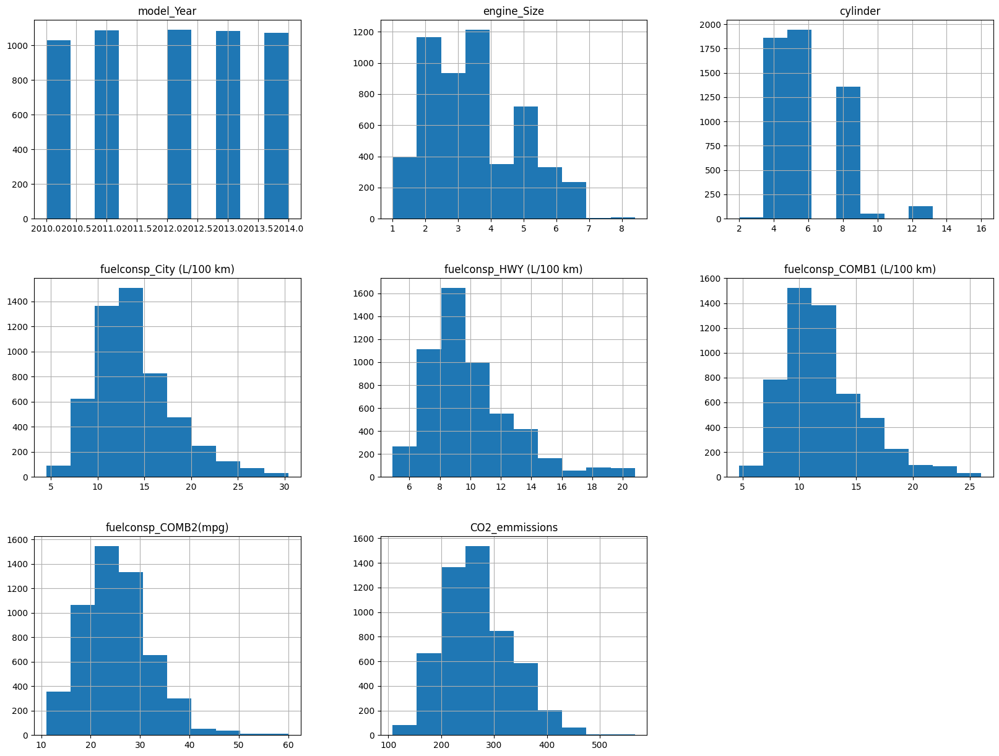

In [29]:
plt.figure(dpi=200)
df.hist(figsize = (20,15))
plt.show()


The distribution for cylinders appears to be discrete.

The distribution for fuelConsCity, fuelConHWY and fuelConsCOMB appears to be right skewed. This can also be confirmed by looking at the mean and median

In [30]:
df.mean()# mean of the features

model_Year                    2012.014742
engine_Size                      3.491901
cylinder                         5.962120
fuelconsp_City (L/100 km)       13.902650
fuelconsp_HWY (L/100 km)         9.932208
fuelconsp_COMB1 (L/100 km)      12.116328
fuelconsp_COMB2(mpg)            25.168875
CO2_emmissions                 267.660198
dtype: float64

In [31]:
df.median()# median of the features

model_Year                    2012.0
engine_Size                      3.5
cylinder                         6.0
fuelconsp_City (L/100 km)       13.2
fuelconsp_HWY (L/100 km)         9.3
fuelconsp_COMB1 (L/100 km)      11.4
fuelconsp_COMB2(mpg)            25.0
CO2_emmissions                 260.0
dtype: float64

In [32]:
df.describe(include= "all").transpose() # printing the basic statistics of the dataset 

,count,unique,top,freq,mean,std,min,25%,50%,75%,max
model_Year,5359.0,NaN,NaN,NaN,2012.014742,1.404536,2010.0,2011.0,2012.0,2013.0,2014.0
MAKE,5359,45,CHEVROLET,521,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Model#,5359,1210,SILVERADO,33,NaN,NaN,NaN,NaN,NaN,NaN,NaN
vehicle_Class,5359,17,SUV,760,NaN,NaN,NaN,NaN,NaN,NaN,NaN
engine_Size,5359.0,NaN,NaN,NaN,3.491901,1.390957,1.0,2.4,3.5,4.6,8.4
cylinder,5359.0,NaN,NaN,NaN,5.96212,1.872838,2.0,4.0,6.0,8.0,16.0
transmission,5359,22,AS6,1058,NaN,NaN,NaN,NaN,NaN,NaN,NaN
fuel_Type,5359,4,X,2663,NaN,NaN,NaN,NaN,NaN,NaN,NaN
fuelconsp_City (L/100 km),5359.0,NaN,NaN,NaN,13.90265,4.162894,4.5,11.0,13.2,16.0,30.4
fuelconsp_HWY (L/100 km),5359.0,NaN,NaN,NaN,9.932208,2.807196,4.9,8.0,9.3,11.2,20.8


In [33]:
df.describe().transpose()

,count,mean,std,min,25%,50%,75%,max
model_Year,5359.0,2012.014742,1.404536,2010.0,2011.0,2012.0,2013.0,2014.0
engine_Size,5359.0,3.491901,1.390957,1.0,2.4,3.5,4.6,8.4
cylinder,5359.0,5.962120,1.872838,2.0,4.0,6.0,8.0,16.0
fuelconsp_City (L/100 km),5359.0,13.902650,4.162894,4.5,11.0,13.2,16.0,30.4
fuelconsp_HWY (L/100 km),5359.0,9.932208,2.807196,4.9,8.0,9.3,11.2,20.8
fuelconsp_COMB1 (L/100 km),5359.0,12.116328,3.524127,4.7,9.7,11.4,13.9,26.0
fuelconsp_COMB2(mpg),5359.0,25.168875,6.956407,11.0,20.0,25.0,29.0,60.0
CO2_emmissions,5359.0,267.660198,64.317040,108.0,221.0,260.0,305.0,566.0


# Tools for categorical data

Most machine learning algorithms accept only numerical features.
Therefore there is a need to convert text to numbers (dummy variables).
The two methods used are: Label Encoding and One Hot Encoding.
Label encoding assigns labels to the categories while one hot encoding converts each category to a column
with 1 assigned to indicate the position of the data and 0 assigned to the rest of the columns.

In [34]:
df.reset_index(inplace = True) 
df.drop(df[['index']], axis = 1, inplace = True) 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5359 entries, 0 to 5358
Data columns (total 13 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   model_Year                  5359 non-null   int32  
 1   MAKE                        5359 non-null   object 
 2   Model#                      5359 non-null   object 
 3   vehicle_Class               5359 non-null   object 
 4   engine_Size                 5359 non-null   float64
 5   cylinder                    5359 non-null   float64
 6   transmission                5359 non-null   object 
 7   fuel_Type                   5359 non-null   object 
 8   fuelconsp_City (L/100 km)   5359 non-null   float64
 9   fuelconsp_HWY (L/100 km)    5359 non-null   float64
 10  fuelconsp_COMB1 (L/100 km)  5359 non-null   float64
 11  fuelconsp_COMB2(mpg)        5359 non-null   float64
 12  CO2_emmissions              5359 non-null   int32  
dtypes: float64(6), int32(2), object(5

# Seperation of numeric and categorical variable

In [35]:
cat_df = df.select_dtypes(include = 'object') # obtains all the datatypes that are objects  
cat_df 

,MAKE,Model#,vehicle_Class,transmission,fuel_Type
0,ACURA,CSX,COMPACT,AS5,X
1,ACURA,CSX,COMPACT,M5,X
2,ACURA,CSX,COMPACT,M6,Z
3,ACURA,MDX AWD,SUV,AS6,Z
4,ACURA,RDX AWD TURBO,SUV,AS5,Z
...,...,...,...,...,...
5354,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5355,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5356,VOLVO,XC70 AWD,SUV - SMALL,AS6,X
5357,VOLVO,XC70 AWD,SUV - SMALL,AS6,X


In [36]:
num_df = df.select_dtypes(include = 'number') # obtains all the datatypes that are numbers  
num_df 

,model_Year,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions
0,2010,2.0,4.0,10.9,7.8,9.5,30.0,219
1,2010,2.0,4.0,10.0,7.6,8.9,32.0,205
2,2010,2.0,4.0,11.6,8.1,10.0,28.0,230
3,2010,3.7,6.0,14.8,11.3,13.2,21.0,304
4,2010,2.3,4.0,13.2,10.3,11.9,24.0,274
...,...,...,...,...,...,...,...,...
5354,2014,3.0,6.0,13.4,9.8,11.8,24.0,271
5355,2014,3.2,6.0,13.2,9.5,11.5,25.0,264
5356,2014,3.0,6.0,13.4,9.8,11.8,24.0,271
5357,2014,3.2,6.0,12.9,9.3,11.3,25.0,260


In [37]:
df.fuel_Type.nunique() # checking the number of unique variable of columns requiring one hot encoding

4

In [38]:
df.fuel_Type.unique() 

array(['X', 'Z', 'D', 'E'], dtype=object)

# One Hot Encoding

In [39]:
ohe = OneHotEncoder() # declares an instance of the object  
ohe_data=ohe.fit_transform(cat_df[['fuel_Type']]).toarray() # applies the object to data  
feature_labels = ohe.categories_ # the labels are stored here
feature_labels = np.array(feature_labels).ravel() 
df_ohe = pd.DataFrame(ohe_data, columns = feature_labels ) # creating a dataframe for the ohe variable 
df_ohe.drop('Z', axis = 1, inplace = True) # removing one axis from the fuel type column to prevent multicolinearity 
ohe_df = pd.concat([num_df,df_ohe], axis = 1) # combining the original dataframe (df) with onehot encoded fuel type i.e df_ohe 
# this will split all the values in fuel type into variables excluding one value that was dropped to prevent multicolinearity 
#an alternative method for this encoding process is using pd.getdummies()
ohe_df 

,model_Year,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions,D,E,X
0,2010,2.0,4.0,10.9,7.8,9.5,30.0,219,0.0,0.0,1.0
1,2010,2.0,4.0,10.0,7.6,8.9,32.0,205,0.0,0.0,1.0
2,2010,2.0,4.0,11.6,8.1,10.0,28.0,230,0.0,0.0,0.0
3,2010,3.7,6.0,14.8,11.3,13.2,21.0,304,0.0,0.0,0.0
4,2010,2.3,4.0,13.2,10.3,11.9,24.0,274,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...
5354,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,0.0,0.0,1.0
5355,2014,3.2,6.0,13.2,9.5,11.5,25.0,264,0.0,0.0,1.0
5356,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,0.0,0.0,1.0
5357,2014,3.2,6.0,12.9,9.3,11.3,25.0,260,0.0,0.0,1.0


# Label Encoding

In [40]:
leb = LabelEncoder()# declares an instance of the object 
leb_df = leb.fit_transform(cat_df[['fuel_Type']])# applies the object to data 
df_leb = pd.DataFrame(leb_df, columns = ['fuel_Type']) # creates a dataframe 
leb_df = pd.concat([num_df,df_leb], axis = 1) 
leb_df 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\preprocessing\_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


,model_Year,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions,fuel_Type
0,2010,2.0,4.0,10.9,7.8,9.5,30.0,219,2
1,2010,2.0,4.0,10.0,7.6,8.9,32.0,205,2
2,2010,2.0,4.0,11.6,8.1,10.0,28.0,230,3
3,2010,3.7,6.0,14.8,11.3,13.2,21.0,304,3
4,2010,2.3,4.0,13.2,10.3,11.9,24.0,274,3
...,...,...,...,...,...,...,...,...,...
5354,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,2
5355,2014,3.2,6.0,13.2,9.5,11.5,25.0,264,2
5356,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,2
5357,2014,3.2,6.0,12.9,9.3,11.3,25.0,260,2


In [41]:
leb_df.columns

Index(['model_Year', 'engine_Size', 'cylinder', 'fuelconsp_City (L/100 km)',
       'fuelconsp_HWY (L/100 km)', 'fuelconsp_COMB1 (L/100 km)',
       'fuelconsp_COMB2(mpg)', 'CO2_emmissions', 'fuel_Type'],
      dtype='object')

The disadvantage of one hot encoding is that it increases the dimensions of the dataset while the advantage is that it does not create an ordering.
The disadvantage of label encoding is that it creates an ordering of the variable while the advantage is that it does not increase the dimension of the dataset.

I will be using the result from the label encoding

# Question 2

Attempt to use all the numerical continuous variables in the dataset provided to build a model to predict the CO2 emission. Perform exploratory data analysis to select a subset of the variables and repeat the procedure. Compare your models and report if there are any differences in the models’ performances? Explain your findings.

All the numerical continuous variables that will be examined have been grouped into a new dataframe called le_df which includes all original numerical variables with label encoded numeric variable, fuel-type. All other categorical variables were excluded from the label encoding since they willnot be useful for the building of the models

we have to use exploratory data Analysis in checking on the correlation of the features for linear regression task on predicting the CO2 emmission 


In [42]:
# creating correlation matrix
corr_matrix = leb_df.corr()

<AxesSubplot:>

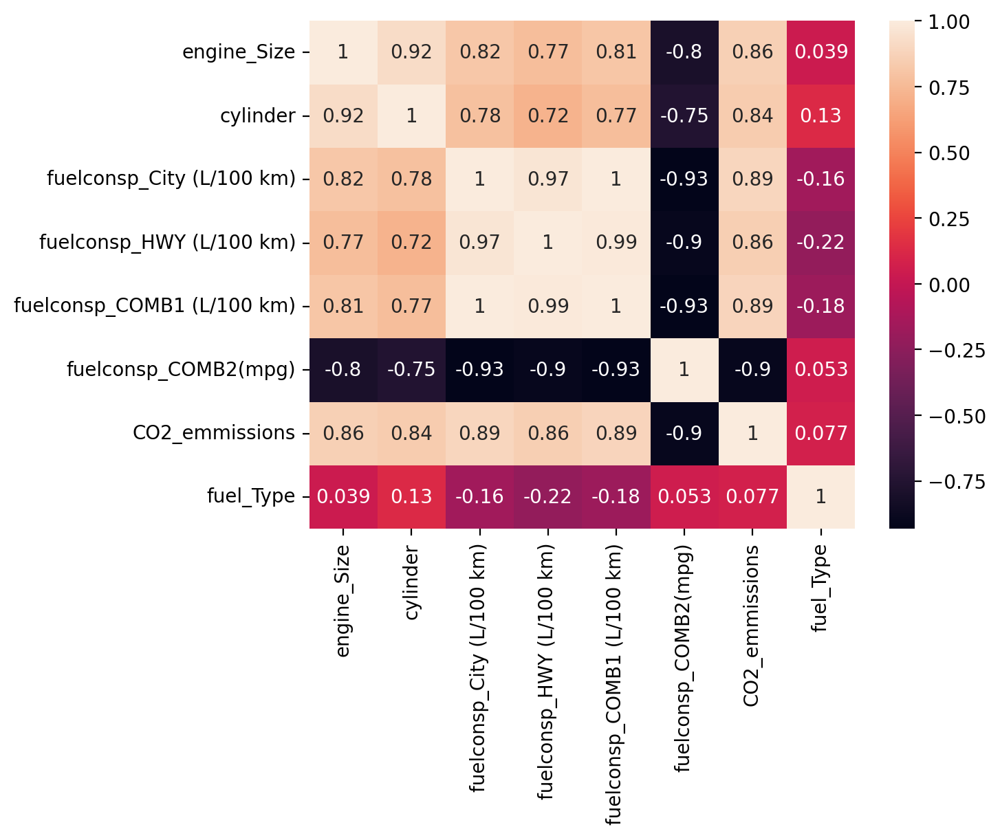

In [43]:
plt.figure(dpi=200) 
leb_df.drop(df[['model_Year']], axis = 1, inplace = True) # Model Year is not needed in this analysis since it's almost categorical
sns.heatmap(leb_df.corr(), annot = True) 
# checking for correlation between numeric variables to see if any of the variables have strong relationship 

it can be seen that there is a good correlation between the variable except for fueltype which was initially a categorical variable
the variables with the highest correlation with the targets are

fuel consumption COMB2 with-0.9 negative correlation
fuel consumption city with 0.89 positive correlation

In [44]:
print(df.columns.tolist())

['model_Year', 'MAKE', 'Model#', 'vehicle_Class', 'engine_Size', 'cylinder', 'transmission', 'fuel_Type', 'fuelconsp_City (L/100 km)', 'fuelconsp_HWY (L/100 km)', 'fuelconsp_COMB1 (L/100 km)', 'fuelconsp_COMB2(mpg)', 'CO2_emmissions']


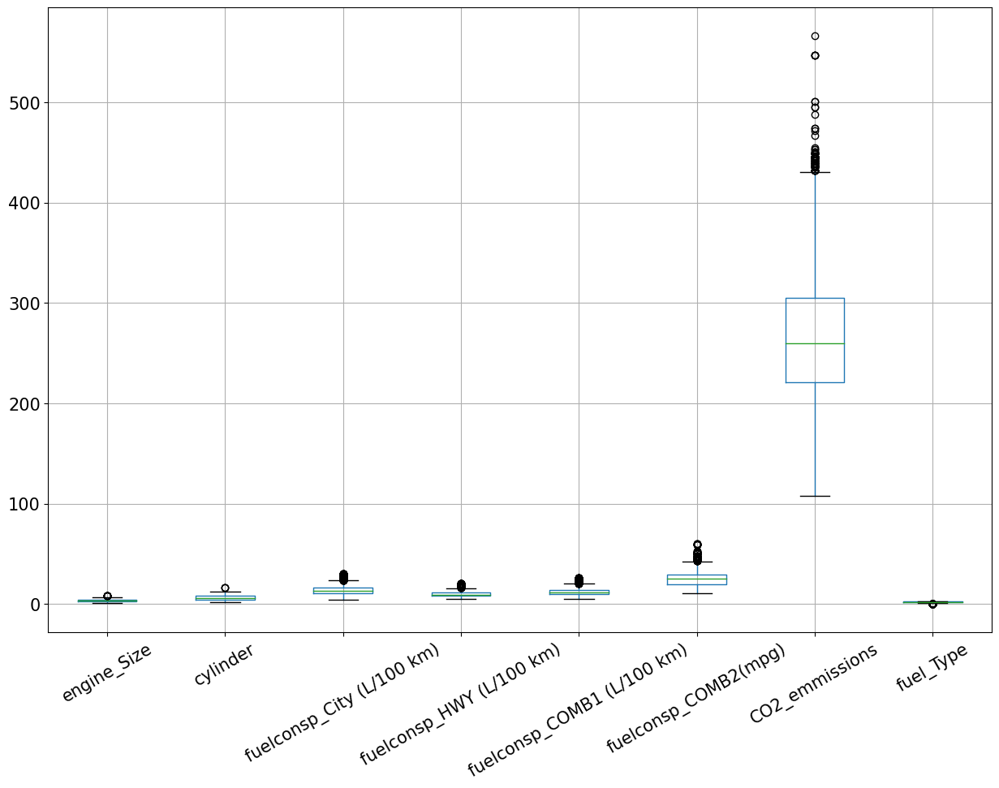

In [45]:
leb_df.boxplot(figsize = (15,10), fontsize = 15, rot = 30) 
# to detect outliers
plt.show() 

The boxplot shows that some of the variables exert dominance over the others as 
it can be observed that the values of CO2 emission 
are bigger than the other columns, and as such, there will be  need for scaling or normalizing.

# Building the machine learning model
Linear regression is used for building machine learning with numeric data/ variables. 2 types of regression models will be evaluated for their performance; they include

1. Simple linear regression model
2. Multi-linear regression model

Creating the train, validation and test dataset Let's split our dataset into train and test sets. 80% of the entire dataset will be used for training and 20% for testing. Futhermore, we split the 80% of train data to validation data(20%) for validation.

In [46]:
X = leb_df.drop('CO2_emmissions', axis = 1) # dataset without the label (target variable)
y = leb_df['CO2_emmissions'] # dataset with the label (target variable)
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) 
 
X,y=X_train,y_train 
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42) 
# train dataset was split again to give be 60 percent of the dataset
# test will be 20
# validation : 20

In [47]:
X_train

,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),fuel_Type
2300,3.7,5.0,14.9,11.0,13.1,22.0,2
1000,2.4,5.0,12.0,8.5,10.4,27.0,2
4496,3.6,6.0,14.8,9.9,12.6,22.0,2
3823,3.6,6.0,14.8,11.8,13.4,21.0,2
2423,6.4,8.0,16.8,10.4,13.9,20.0,3
...,...,...,...,...,...,...,...
3677,4.3,6.0,16.7,13.4,15.2,19.0,2
4600,3.6,6.0,16.8,10.3,13.9,20.0,1
3959,5.5,8.0,15.2,10.4,13.0,22.0,3
2616,6.0,8.0,22.7,15.0,19.2,15.0,2


#60 percent of 5360 will yield 3429

In [48]:
y_train

2300    301
1000    239
4496    290
3823    308
2423    320
       ... 
3677    350
4600    222
3959    299
2616    442
1497    344
Name: CO2_emmissions, Length: 3429, dtype: int32

# Scaling the dataset

In [49]:
scaler = MinMaxScaler() 
X_train_scaled = scaler.fit_transform(X_train) 
X_test_scaled = scaler.transform(X_test) 
X_val_scaled = scaler.transform(X_val) 

In [50]:
#converting to pandas dataframe 
X_train_scaled = pd.DataFrame(X_train_scaled, columns = X_train.columns)  
X_test_scaled = pd.DataFrame(X_test_scaled, columns = X_test.columns) 
X_val_scaled = pd.DataFrame(X_val_scaled, columns = X_val.columns) 

# Simple Regression Model
Reshaping: sklearn accepts data in matrix form i.e. row and column. Hence when the data is a single feature, we need to reshape the data to have row and column. Note: the target does not need to be reshaped.
In order to reshape a series, we first need to convert to numpy arrary using series.to_numpy() and apply the .reshape(-1,1) funtion, where -1 is a place holder for all the rows and 1 represents the column

In [51]:
X_train_scaled['engine_Size'].shape # sklearn accepts data in rows and columns 

(3429,)

In [52]:
# Reshaping the attribute 
X_train_scaled_EngSize=X_train_scaled['engine_Size'].to_numpy().reshape(-1,1)  
X_val_scaled_EngSize = X_val_scaled['engine_Size'].to_numpy().reshape(-1,1) 
X_test_scaled_EngSize = X_test_scaled['engine_Size'].to_numpy().reshape(-1,1) 

In [53]:
model = LinearRegression() #instantiating the model

In [54]:
# The model test report 
def model_test_report(model): 
    model.fit(X_train_scaled_EngSize,y_train) 
    basem_preds = model.predict(X_test_scaled_EngSize)     
    mean_abs = mean_absolute_error(y_test,basem_preds) 
    mean_squared = mean_squared_error(y_test,basem_preds) 
    print(f"The outcome of the mean_absolute_error is: {mean_abs:.2f}") 
    print(f"The outcome of the root mean squared error is : {np.sqrt(mean_squared):.2f}") 
    print(f"The outcome of the coefficient of determination is: {r2_score(y_test,basem_preds):.2f}") 
 
         
model_test_report(model)  

The outcome of the mean_absolute_error is: 24.48
The outcome of the root mean squared error is : 33.08
The outcome of the coefficient of determination is: 0.73


In [55]:
leb_df.columns

Index(['engine_Size', 'cylinder', 'fuelconsp_City (L/100 km)',
       'fuelconsp_HWY (L/100 km)', 'fuelconsp_COMB1 (L/100 km)',
       'fuelconsp_COMB2(mpg)', 'CO2_emmissions', 'fuel_Type'],
      dtype='object')

# Multiplelinear regression

In [56]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled[['fuelconsp_COMB2(mpg)','cylinder']],y_train) 
    basem_preds = model.predict(X_test_scaled[['fuelconsp_COMB2(mpg)','cylinder']])     
    mean_abs = mean_absolute_error(y_test,basem_preds) 
    mean_squared = mean_squared_error(y_test,basem_preds) 
    print(f"The outcome of the mean_absolute_error is: {mean_abs:.2f}") 
    print(f"The outcome of the root mean squared error is : {np.sqrt(mean_squared):.2f}") 
    print(f"The outcome of the coefficient of determination is: {r2_score(y_test,basem_preds):.2f}") 
 
report_model_test(model)

The outcome of the mean_absolute_error is: 15.45
The outcome of the root mean squared error is : 23.44
The outcome of the coefficient of determination is: 0.87


# Findings

the Multiple linear regression has a lower mean absolute error than the Simple Regression Model: the lower the error, the better the model
the Multiple linear regression has a higher coefficient of determination of 0.87 than Simple Regression Model of 0.73
In conclusion, the Multiple linear regression (fuelConsp_COMB(mpg) and cylinder variables) performed better than simple linear regression.

# Question 3

Determine whether there were any noticeable improvements in the CO2 emission from year 2010 to year 2014? Explain your findings.

In [57]:
# reloading the dataset
df_yr= pd.read_csv('MY2010-2014 Fuel Consumption Ratings 5-cycle.csv') # loading the dataset
df_yr.head()

,MODEL,MAKE,MODEL.1,VEHICLE CLASS,ENGINE SIZE,CYLINDERS,TRANSMISSION,FUEL,FUEL CONSUMPTION*,Unnamed: 9,Unnamed: 10,Unnamed: 11,CO2 EMISSIONS
0,YEAR,NaN,# = high output engine,NaN,(L),NaN,NaN,TYPE,CITY (L/100 km),HWY (L/100 km),COMB (L/100 km),COMB (mpg),(g/km)
1,2010,ACURA,CSX,COMPACT,2,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2,4.0,M5,X,10,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2,4.0,M6,Z,11.6,8.1,10,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304


In [58]:
df_yr.rename(columns = {'MODEL': 'model_Year', 'MODEL.1': 'Model#', 
                     'VEHICLE CLASS': 'vehicle_Class', 'ENGINE SIZE': 'engine_Size', 
                     'CYLINDERS': 'cylinder', 'TRANSMISSION': 'transmission', 'FUEL': 'fuel_Type', 
                     'FUEL CONSUMPTION*': 'fuelconsp_City (L/100 km)', 'Unnamed: 9': 'fuelconsp_HWY (L/100 km)',
                    'Unnamed: 10' : 'fuelconsp_COMB1 (L/100 km)', 
                     'Unnamed: 11': 'fuelconsp_COMB2(mpg)', 'CO2 EMISSIONS ': 'CO2_emmissions'}, inplace=True)

In [59]:
df_yr.head()

,model_Year,MAKE,Model#,vehicle_Class,engine_Size,cylinder,transmission,fuel_Type,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions
0,YEAR,NaN,# = high output engine,NaN,(L),NaN,NaN,TYPE,CITY (L/100 km),HWY (L/100 km),COMB (L/100 km),COMB (mpg),(g/km)
1,2010,ACURA,CSX,COMPACT,2,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2,4.0,M5,X,10,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2,4.0,M6,Z,11.6,8.1,10,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304


In [60]:
df_yr.drop([0], inplace = True)
df_yr.head()

,model_Year,MAKE,Model#,vehicle_Class,engine_Size,cylinder,transmission,fuel_Type,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions
1,2010,ACURA,CSX,COMPACT,2,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2,4.0,M5,X,10,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2,4.0,M6,Z,11.6,8.1,10,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304
5,2010,ACURA,RDX AWD TURBO,SUV,2.3,4.0,AS5,Z,13.2,10.3,11.9,24,274


In [61]:
df_yr['model_Year'].unique()

array(['2010', '2011', '2012', '2013', '2014'], dtype=object)

In [62]:
df_yr['CO2_emmissions'] =  df_yr['CO2_emmissions'].astype(float)


In [63]:
df_yr.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5359 entries, 1 to 5359
Data columns (total 13 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   model_Year                  5359 non-null   object 
 1   MAKE                        5359 non-null   object 
 2   Model#                      5359 non-null   object 
 3   vehicle_Class               5359 non-null   object 
 4   engine_Size                 5359 non-null   object 
 5   cylinder                    5359 non-null   float64
 6   transmission                5359 non-null   object 
 7   fuel_Type                   5359 non-null   object 
 8   fuelconsp_City (L/100 km)   5359 non-null   object 
 9   fuelconsp_HWY (L/100 km)    5359 non-null   object 
 10  fuelconsp_COMB1 (L/100 km)  5359 non-null   object 
 11  fuelconsp_COMB2(mpg)        5359 non-null   object 
 12  CO2_emmissions              5359 non-null   float64
dtypes: float64(2), object(11)
memory 

In [64]:
df.isna().sum()

model_Year                    0
MAKE                          0
Model#                        0
vehicle_Class                 0
engine_Size                   0
cylinder                      0
transmission                  0
fuel_Type                     0
fuelconsp_City (L/100 km)     0
fuelconsp_HWY (L/100 km)      0
fuelconsp_COMB1 (L/100 km)    0
fuelconsp_COMB2(mpg)          0
CO2_emmissions                0
dtype: int64

In [65]:
df_yr.columns

Index(['model_Year', 'MAKE', 'Model#', 'vehicle_Class', 'engine_Size',
       'cylinder', 'transmission', 'fuel_Type', 'fuelconsp_City (L/100 km)',
       'fuelconsp_HWY (L/100 km)', 'fuelconsp_COMB1 (L/100 km)',
       'fuelconsp_COMB2(mpg)', 'CO2_emmissions'],
      dtype='object')

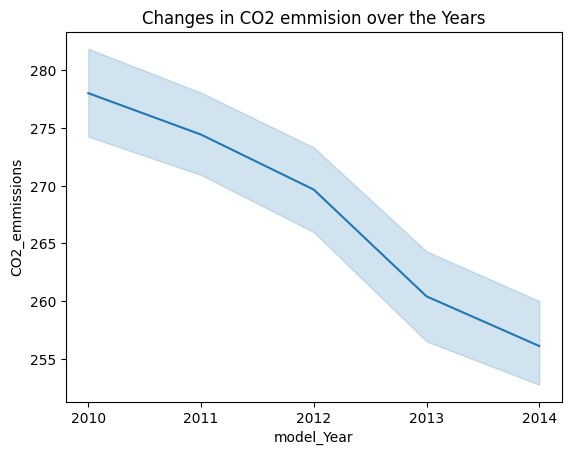

In [66]:
sns.lineplot(df_yr, x = 'model_Year', y= 'CO2_emmissions')
plt.title('Changes in CO2 emmision over the Years')
plt.show()

There is a reduction in the CO2 levels generated from motor models developed from year to year

# QUESTION 4

Using each categorical variable as the target variable at each instance, determine which of the variables performed best in classifying the dataset. Explain your findings.

In [67]:
# reloading the dataset
df_clas = pd.read_csv('MY2010-2014 Fuel Consumption Ratings 5-cycle.csv')
df_clas

,MODEL,MAKE,MODEL.1,VEHICLE CLASS,ENGINE SIZE,CYLINDERS,TRANSMISSION,FUEL,FUEL CONSUMPTION*,Unnamed: 9,Unnamed: 10,Unnamed: 11,CO2 EMISSIONS
0,YEAR,NaN,# = high output engine,NaN,(L),NaN,NaN,TYPE,CITY (L/100 km),HWY (L/100 km),COMB (L/100 km),COMB (mpg),(g/km)
1,2010,ACURA,CSX,COMPACT,2,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2,4.0,M5,X,10,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2,4.0,M6,Z,11.6,8.1,10,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5355,2014,VOLVO,XC60 AWD,SUV - SMALL,3,6.0,AS6,X,13.4,9.8,11.8,24,271
5356,2014,VOLVO,XC60 AWD,SUV - SMALL,3.2,6.0,AS6,X,13.2,9.5,11.5,25,264
5357,2014,VOLVO,XC70 AWD,SUV - SMALL,3,6.0,AS6,X,13.4,9.8,11.8,24,271
5358,2014,VOLVO,XC70 AWD,SUV - SMALL,3.2,6.0,AS6,X,12.9,9.3,11.3,25,260


In [68]:
df_clas.rename(columns = {'MODEL': 'model_Year', 'MODEL.1': 'Model#', 
                     'VEHICLE CLASS': 'vehicle_Class', 'ENGINE SIZE': 'engine_Size', 
                     'CYLINDERS': 'cylinder', 'TRANSMISSION': 'transmission', 'FUEL': 'fuel_Type', 
                     'FUEL CONSUMPTION*': 'fuelconsp_City (L/100 km)', 'Unnamed: 9': 'fuelconsp_HWY (L/100 km)',
                    'Unnamed: 10' : 'fuelconsp_COMB1 (L/100 km)', 
                     'Unnamed: 11': 'fuelconsp_COMB2(mpg)', 'CO2 EMISSIONS ': 'CO2_emmissions'}, inplace=True)

In [69]:
df_clas

,model_Year,MAKE,Model#,vehicle_Class,engine_Size,cylinder,transmission,fuel_Type,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions
0,YEAR,NaN,# = high output engine,NaN,(L),NaN,NaN,TYPE,CITY (L/100 km),HWY (L/100 km),COMB (L/100 km),COMB (mpg),(g/km)
1,2010,ACURA,CSX,COMPACT,2,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2,4.0,M5,X,10,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2,4.0,M6,Z,11.6,8.1,10,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5355,2014,VOLVO,XC60 AWD,SUV - SMALL,3,6.0,AS6,X,13.4,9.8,11.8,24,271
5356,2014,VOLVO,XC60 AWD,SUV - SMALL,3.2,6.0,AS6,X,13.2,9.5,11.5,25,264
5357,2014,VOLVO,XC70 AWD,SUV - SMALL,3,6.0,AS6,X,13.4,9.8,11.8,24,271
5358,2014,VOLVO,XC70 AWD,SUV - SMALL,3.2,6.0,AS6,X,12.9,9.3,11.3,25,260


In [70]:
df_clas.drop([0], inplace = True)
df_clas

,model_Year,MAKE,Model#,vehicle_Class,engine_Size,cylinder,transmission,fuel_Type,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions
1,2010,ACURA,CSX,COMPACT,2,4.0,AS5,X,10.9,7.8,9.5,30,219
2,2010,ACURA,CSX,COMPACT,2,4.0,M5,X,10,7.6,8.9,32,205
3,2010,ACURA,CSX,COMPACT,2,4.0,M6,Z,11.6,8.1,10,28,230
4,2010,ACURA,MDX AWD,SUV,3.7,6.0,AS6,Z,14.8,11.3,13.2,21,304
5,2010,ACURA,RDX AWD TURBO,SUV,2.3,4.0,AS5,Z,13.2,10.3,11.9,24,274
...,...,...,...,...,...,...,...,...,...,...,...,...,...
5355,2014,VOLVO,XC60 AWD,SUV - SMALL,3,6.0,AS6,X,13.4,9.8,11.8,24,271
5356,2014,VOLVO,XC60 AWD,SUV - SMALL,3.2,6.0,AS6,X,13.2,9.5,11.5,25,264
5357,2014,VOLVO,XC70 AWD,SUV - SMALL,3,6.0,AS6,X,13.4,9.8,11.8,24,271
5358,2014,VOLVO,XC70 AWD,SUV - SMALL,3.2,6.0,AS6,X,12.9,9.3,11.3,25,260


In [71]:
df_clas.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5359 entries, 1 to 5359
Data columns (total 13 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   model_Year                  5359 non-null   object 
 1   MAKE                        5359 non-null   object 
 2   Model#                      5359 non-null   object 
 3   vehicle_Class               5359 non-null   object 
 4   engine_Size                 5359 non-null   object 
 5   cylinder                    5359 non-null   float64
 6   transmission                5359 non-null   object 
 7   fuel_Type                   5359 non-null   object 
 8   fuelconsp_City (L/100 km)   5359 non-null   object 
 9   fuelconsp_HWY (L/100 km)    5359 non-null   object 
 10  fuelconsp_COMB1 (L/100 km)  5359 non-null   object 
 11  fuelconsp_COMB2(mpg)        5359 non-null   object 
 12  CO2_emmissions              5359 non-null   object 
dtypes: float64(1), object(12)
memory 

In [72]:
# converting variables to their correct data types
df_clas['model_Year'] = df_clas['model_Year'].astype(float)
df_clas['model_Year'] = df_clas['model_Year'].astype(int)
df_clas['engine_Size'] = df_clas['engine_Size'].astype(float)
df_clas['cylinder'] = df_clas['cylinder'].astype(float)
df_clas['fuelconsp_City (L/100 km)'] = df_clas['fuelconsp_City (L/100 km)'].astype(float)
df_clas[ 'fuelconsp_HWY (L/100 km)'] = df_clas[ 'fuelconsp_HWY (L/100 km)'].astype(float)
df_clas['fuelconsp_COMB1 (L/100 km)'] = df_clas['fuelconsp_COMB1 (L/100 km)'].astype(float)
df_clas[ 'fuelconsp_COMB2(mpg)'] = df_clas['fuelconsp_COMB2(mpg)'].astype(float)
df_clas['CO2_emmissions'] = df_clas['CO2_emmissions'].astype(float)
df_clas['CO2_emmissions'] = df_clas['CO2_emmissions'].astype(int)

df_clas.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 5359 entries, 1 to 5359
Data columns (total 13 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   model_Year                  5359 non-null   int32  
 1   MAKE                        5359 non-null   object 
 2   Model#                      5359 non-null   object 
 3   vehicle_Class               5359 non-null   object 
 4   engine_Size                 5359 non-null   float64
 5   cylinder                    5359 non-null   float64
 6   transmission                5359 non-null   object 
 7   fuel_Type                   5359 non-null   object 
 8   fuelconsp_City (L/100 km)   5359 non-null   float64
 9   fuelconsp_HWY (L/100 km)    5359 non-null   float64
 10  fuelconsp_COMB1 (L/100 km)  5359 non-null   float64
 11  fuelconsp_COMB2(mpg)        5359 non-null   float64
 12  CO2_emmissions              5359 non-null   int32  
dtypes: float64(6), int32(2), object(5

In [73]:
df_clas.reset_index(inplace = True) 
df_clas.drop(df_clas[['index']], axis = 1, inplace = True) 

In [74]:
# identifying the categorical variables
df_clas.select_dtypes(exclude = "number").head()

,MAKE,Model#,vehicle_Class,transmission,fuel_Type
0,ACURA,CSX,COMPACT,AS5,X
1,ACURA,CSX,COMPACT,M5,X
2,ACURA,CSX,COMPACT,M6,Z
3,ACURA,MDX AWD,SUV,AS6,Z
4,ACURA,RDX AWD TURBO,SUV,AS5,Z


checking the number of unique features in various categorical variables

In [75]:
df_clas.columns

Index(['model_Year', 'MAKE', 'Model#', 'vehicle_Class', 'engine_Size',
       'cylinder', 'transmission', 'fuel_Type', 'fuelconsp_City (L/100 km)',
       'fuelconsp_HWY (L/100 km)', 'fuelconsp_COMB1 (L/100 km)',
       'fuelconsp_COMB2(mpg)', 'CO2_emmissions'],
      dtype='object')

In [76]:
df_clas['Model#'].nunique()

1210

In [77]:
df_clas['MAKE'].nunique()

45

In [78]:
df_clas['vehicle_Class'].nunique()

17

In [79]:
df_clas['transmission'].nunique()

22

In [80]:
df_clas['fuel_Type'].nunique()

4

In [81]:
df_clas['cylinder'].nunique()

9

In [82]:
num_df_clas = df_clas.select_dtypes(include = 'number') # obtains all the datatypes that are numbers  
num_df_clas

,model_Year,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions
0,2010,2.0,4.0,10.9,7.8,9.5,30.0,219
1,2010,2.0,4.0,10.0,7.6,8.9,32.0,205
2,2010,2.0,4.0,11.6,8.1,10.0,28.0,230
3,2010,3.7,6.0,14.8,11.3,13.2,21.0,304
4,2010,2.3,4.0,13.2,10.3,11.9,24.0,274
...,...,...,...,...,...,...,...,...
5354,2014,3.0,6.0,13.4,9.8,11.8,24.0,271
5355,2014,3.2,6.0,13.2,9.5,11.5,25.0,264
5356,2014,3.0,6.0,13.4,9.8,11.8,24.0,271
5357,2014,3.2,6.0,12.9,9.3,11.3,25.0,260


In [83]:
cat_df_clas = df_clas.select_dtypes(exclude = 'number') # obtains all the datatypes that are numbers  
cat_df_clas

,MAKE,Model#,vehicle_Class,transmission,fuel_Type
0,ACURA,CSX,COMPACT,AS5,X
1,ACURA,CSX,COMPACT,M5,X
2,ACURA,CSX,COMPACT,M6,Z
3,ACURA,MDX AWD,SUV,AS6,Z
4,ACURA,RDX AWD TURBO,SUV,AS5,Z
...,...,...,...,...,...
5354,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5355,VOLVO,XC60 AWD,SUV - SMALL,AS6,X
5356,VOLVO,XC70 AWD,SUV - SMALL,AS6,X
5357,VOLVO,XC70 AWD,SUV - SMALL,AS6,X


# LABEL ENCODING
Conversion of all categorical variables to numbers

In [84]:
# fuel type
df_clas.fuel_Type.unique()

array(['X', 'Z', 'D', 'E'], dtype=object)

In [85]:
leb = LabelEncoder()# declares an instance of the object 
leb_data = leb.fit_transform(cat_df_clas [['fuel_Type']])# applies the object to data 
df_leb = pd.DataFrame(leb_data, columns = ['fuel_Type']) # creates a dataframe 
fuel_leb_df = pd.concat([num_df_clas,df_leb], axis = 1) 
fuel_leb_df 



# ohe = OneHotEncoder() # declares an instance of the object  
# ohe_data=ohe.fit_transform(categorical_df_class[['FuelType']]).toarray() # applies the object to data  
# feature_labels = ohe.categories_ # the labels are stored here
# feature_labels = np.array(feature_labels).ravel() 
# fuel_df_ohe = pd.DataFrame(ohe_data, columns = feature_labels ) # creating a dataframe for the ohe variable 
# fuel_df_ohe.drop('Z', axis = 1, inplace = True) # removing one axis from the fuel type column to prevent multicolinearity 
# #ohe_df = pd.concat([numeric_df_class,df_ohe], axis = 1) # combining the original dataframe (df) with onehot encoded fuel type i.e df_ohe 
# # this will split all the values in fuel type into variables excluding one value that was dropped to prevent multicolinearity 
# #an alternative method for this encoding process is using pd.getdummies()
# fuel_df_ohe



c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\preprocessing\_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


,model_Year,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions,fuel_Type
0,2010,2.0,4.0,10.9,7.8,9.5,30.0,219,2
1,2010,2.0,4.0,10.0,7.6,8.9,32.0,205,2
2,2010,2.0,4.0,11.6,8.1,10.0,28.0,230,3
3,2010,3.7,6.0,14.8,11.3,13.2,21.0,304,3
4,2010,2.3,4.0,13.2,10.3,11.9,24.0,274,3
...,...,...,...,...,...,...,...,...,...
5354,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,2
5355,2014,3.2,6.0,13.2,9.5,11.5,25.0,264,2
5356,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,2
5357,2014,3.2,6.0,12.9,9.3,11.3,25.0,260,2


In [86]:
# make
df_clas.MAKE.unique()

array(['ACURA', 'ASTON MARTIN', 'AUDI', 'BENTLEY', 'BMW', 'BUGATTI',
       'BUICK', 'CADILLAC', 'CHEVROLET', 'CHRYSLER', 'DODGE', 'FERRARI',
       'FORD', 'GMC', 'HONDA', 'HUMMER', 'HYUNDAI', 'INFINITI', 'JAGUAR',
       'JEEP', 'KIA', 'LAMBORGHINI', 'LAND ROVER', 'LEXUS', 'LINCOLN',
       'MASERATI', 'MAZDA', 'MERCEDES-BENZ', 'MINI', 'MITSUBISHI',
       'NISSAN', 'PONTIAC', 'PORSCHE', 'ROLLS-ROYCE', 'SMART', 'SUBARU',
       'SUZUKI', 'TOYOTA', 'VOLKSWAGEN', 'VOLVO', 'SCION', 'FIAT', 'RAM',
       'SRT', 'ALFA ROMEO'], dtype=object)

In [87]:
leb = LabelEncoder()# declares an instance of the object 
leb_data = leb.fit_transform(cat_df_clas [['MAKE']])# applies the object to data 
df_leb = pd.DataFrame(leb_data, columns = ['MAKE']) # creates a dataframe 
make_leb_df = pd.concat([num_df_clas,df_leb], axis = 1) 
make_leb_df 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\preprocessing\_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


,model_Year,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions,MAKE
0,2010,2.0,4.0,10.9,7.8,9.5,30.0,219,0
1,2010,2.0,4.0,10.0,7.6,8.9,32.0,205,0
2,2010,2.0,4.0,11.6,8.1,10.0,28.0,230,0
3,2010,3.7,6.0,14.8,11.3,13.2,21.0,304,0
4,2010,2.3,4.0,13.2,10.3,11.9,24.0,274,0
...,...,...,...,...,...,...,...,...,...
5354,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,44
5355,2014,3.2,6.0,13.2,9.5,11.5,25.0,264,44
5356,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,44
5357,2014,3.2,6.0,12.9,9.3,11.3,25.0,260,44


In [88]:
# MODEL
df_clas['Model#'].unique()

array(['CSX', 'MDX AWD', 'RDX AWD TURBO', ..., 'HIGHLANDER HYBRID AWD LE',
       'VENZA 4WD', 'JETTA GLI'], dtype=object)

In [89]:
leb = LabelEncoder()# declares an instance of the object 
leb_data = leb.fit_transform(cat_df_clas [['Model#']])# applies the object to data 
df_leb = pd.DataFrame(leb_data, columns = ['Model#']) # creates a dataframe 
Model_leb_df = pd.concat([num_df_clas,df_leb], axis = 1) 
Model_leb_df 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\preprocessing\_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


,model_Year,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions,Model#
0,2010,2.0,4.0,10.9,7.8,9.5,30.0,219,352
1,2010,2.0,4.0,10.0,7.6,8.9,32.0,205,352
2,2010,2.0,4.0,11.6,8.1,10.0,28.0,230,352
3,2010,3.7,6.0,14.8,11.3,13.2,21.0,304,734
4,2010,2.3,4.0,13.2,10.3,11.9,24.0,274,884
...,...,...,...,...,...,...,...,...,...
5354,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,1138
5355,2014,3.2,6.0,13.2,9.5,11.5,25.0,264,1138
5356,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,1142
5357,2014,3.2,6.0,12.9,9.3,11.3,25.0,260,1142


In [90]:
# vehicle class
df_clas.vehicle_Class.unique()

array(['COMPACT', 'SUV', 'MID-SIZE', 'MINICOMPACT', 'TWO-SEATER',
       'STATION WAGON - SMALL', 'SUBCOMPACT', 'STATION WAGON - MID-SIZE',
       'FULL-SIZE', 'PICKUP TRUCK - STANDARD', 'PICKUP TRUCK - SMALL',
       'VAN - CARGO', 'VAN - PASSENGER', 'MINIVAN',
       'SPECIAL PURPOSE VEHICLE', 'SUV - SMALL', 'SUV - STANDARD'],
      dtype=object)

In [91]:
leb = LabelEncoder()# declares an instance of the object 
leb_data = leb.fit_transform(cat_df_clas [['vehicle_Class']])# applies the object to data 
df_leb = pd.DataFrame(leb_data, columns = ['vehicle_Class']) # creates a dataframe 
vclass_leb_df = pd.concat([num_df_clas,df_leb], axis = 1) 
vclass_leb_df 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\preprocessing\_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


,model_Year,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions,vehicle_Class
0,2010,2.0,4.0,10.9,7.8,9.5,30.0,219,0
1,2010,2.0,4.0,10.0,7.6,8.9,32.0,205,0
2,2010,2.0,4.0,11.6,8.1,10.0,28.0,230,0
3,2010,3.7,6.0,14.8,11.3,13.2,21.0,304,11
4,2010,2.3,4.0,13.2,10.3,11.9,24.0,274,11
...,...,...,...,...,...,...,...,...,...
5354,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,12
5355,2014,3.2,6.0,13.2,9.5,11.5,25.0,264,12
5356,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,12
5357,2014,3.2,6.0,12.9,9.3,11.3,25.0,260,12


In [92]:
# transmission
df_clas.transmission.unique()

array(['AS5', 'M5', 'M6', 'AS6', 'AM6', 'AV', 'AS7', 'A6', 'A8', 'A7',
       'AM7', 'A4', 'A5', 'AS4', 'AS8', 'M7', 'AV7', 'AV8', 'AV6', 'AM5',
       'A9', 'AS9'], dtype=object)

In [93]:
leb = LabelEncoder()# declares an instance of the object 
leb_data = leb.fit_transform(cat_df_clas [['transmission']])# applies the object to data 
df_leb = pd.DataFrame(leb_data, columns = ['transmission']) # creates a dataframe 
trans_leb_df = pd.concat([num_df_clas,df_leb], axis = 1) 
trans_leb_df 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\preprocessing\_label.py:116: DataConversionWarning: A column-vector y was passed when a 1d array was expected. Please change the shape of y to (n_samples, ), for example using ravel().
  y = column_or_1d(y, warn=True)


,model_Year,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions,transmission
0,2010,2.0,4.0,10.9,7.8,9.5,30.0,219,10
1,2010,2.0,4.0,10.0,7.6,8.9,32.0,205,19
2,2010,2.0,4.0,11.6,8.1,10.0,28.0,230,20
3,2010,3.7,6.0,14.8,11.3,13.2,21.0,304,11
4,2010,2.3,4.0,13.2,10.3,11.9,24.0,274,10
...,...,...,...,...,...,...,...,...,...
5354,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,11
5355,2014,3.2,6.0,13.2,9.5,11.5,25.0,264,11
5356,2014,3.0,6.0,13.4,9.8,11.8,24.0,271,11
5357,2014,3.2,6.0,12.9,9.3,11.3,25.0,260,11


# Classification

First Target: Using Cylinder as the first target / Label - since it's also categorical in nature
Balance the dataset
Balancing your dataset is an important consideration while building a machine learning model. This is because machine learning learning models learn more with the availability of many examples.
There are several methods, however, here we are using Synthetic Minority Over-sampling Technique. Note: balancing is done based on the target variable.
Plot of the target class(CYLINDERS) to see the distribution of values
As can be seen from the plot the cylinders 4, 6, and 8 have more values than the rest of them. This shows that the dataset is not balanced.

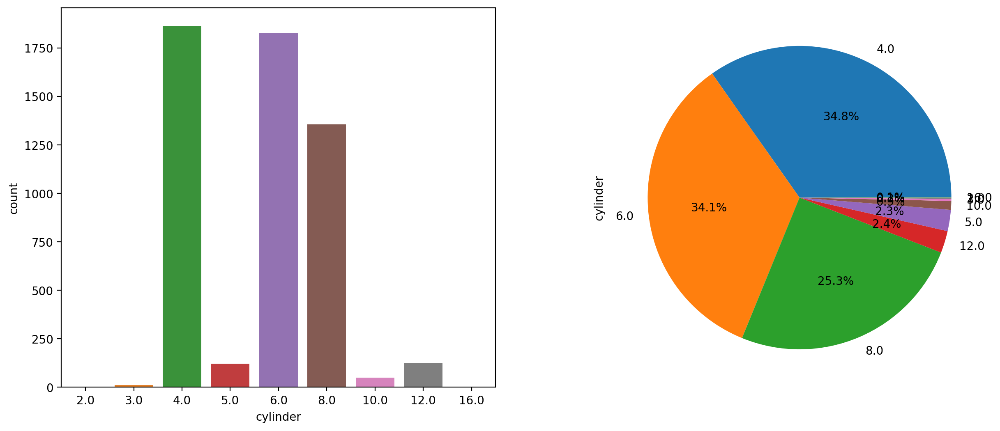

In [94]:
fig, ax_position=plt.subplots(1,2,figsize=(15,6),dpi=200) # creates the framework for the plotting 
a = sns.countplot(x='cylinder', data=leb_df, ax=ax_position[0]) #ax_position[0] specifies plot to be in index 0 
a= df_clas['cylinder'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax_position[1]) #ax_position[1] specifies plot to be in index 1 

In [95]:
# balancing the target variable for efficient machine learning
X = leb_df.drop('cylinder', axis = 1) 
y = leb_df['cylinder'] 

In [96]:
# Applying smote to balance the dataset
from imblearn import over_sampling
from imblearn.over_sampling import SMOTE 
sm = SMOTE(random_state=42, k_neighbors = 2) # The object is created  
X_res, y_res = sm.fit_resample(X, y) # The object is applied 
X, y = X_res, y_res # reassigning the balanced dataset to X,y

# from imblearn import over_sampling
# from imblearn.over_sampling import SMOTE
# balanced = SMOTE()
# x_balanced , y_balanced = balanced.fit_resample(X_train,y_train)

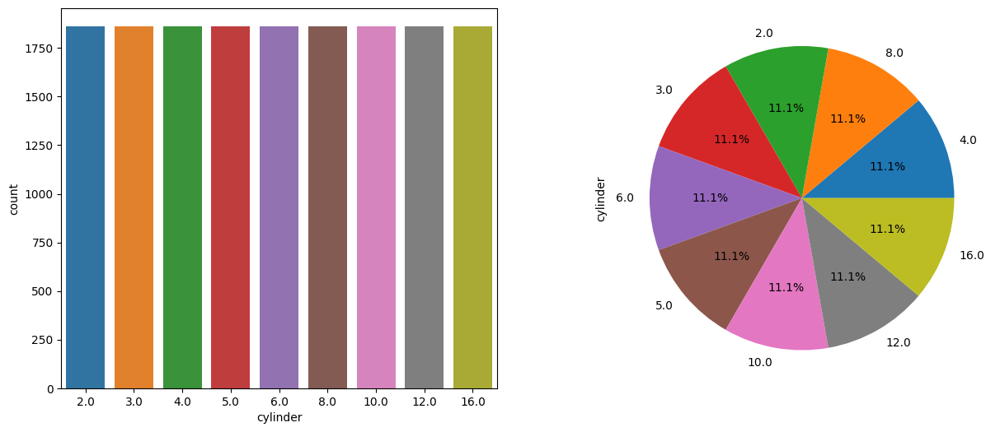

In [97]:
# Plot of the dataset   
df_bal = pd.concat([X_res,y_res], axis = 1) # creating a dataframe for the balanced data 
fig, ax=plt.subplots(1,2,figsize=(15,6)) # creating the axis shell for subplot 
a = sns.countplot(x='cylinder',data=df_bal,  ax=ax[0]) # assigning each of the plot to the axis shell 
a= df_bal['cylinder'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax[1]) # assigning each of the plot to the axis shell 

 the dataset is balance hence, the machine learning will not learn one more than the other
 if it has one sample of a category more than the other, it will learn it more than the fewer category
 this bring about the need for the above balancing

# To split the data into taining and test set, I have to import train test split

In [98]:
#splitting the dataset into train and test set
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2,
 random_state = 42)
X,y=X_train,y_train 
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42) 

In [99]:
#scaling the dataset
scaler = MinMaxScaler() 
X_train_scaled = scaler.fit_transform(X_train) 
X_test_scaled = scaler.transform(X_test) 
X_val_scaled = scaler.transform(X_val) 

# Base models

A base model is a simple model that acts as a reference in a machine learning project.

Logistic regression

In [100]:
from sklearn.linear_model import LogisticRegression 

In [101]:
model = LogisticRegression() 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


              precision    recall  f1-score   support

         2.0       0.97      1.00      0.98       375
         3.0       0.95      1.00      0.98       399
         4.0       0.65      0.78      0.71       340
         5.0       0.64      0.35      0.45       416
         6.0       0.64      0.82      0.72       369
         8.0       0.94      0.74      0.83       400
        10.0       0.81      0.83      0.82       369
        12.0       0.78      0.91      0.84       338
        16.0       0.97      1.00      0.99       348

    accuracy                           0.82      3354
   macro avg       0.82      0.82      0.81      3354
weighted avg       0.82      0.82      0.81      3354



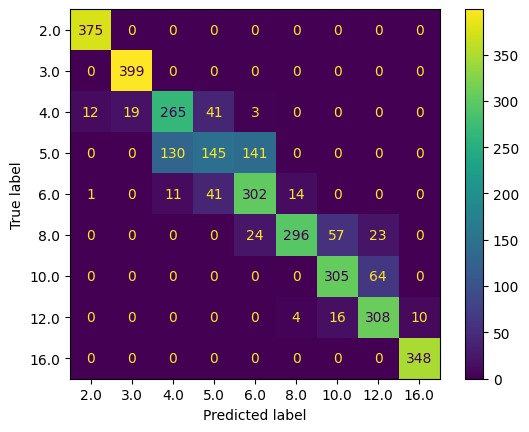

<Figure size 8000x8000 with 0 Axes>

In [102]:
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model)

in the classification metrix originated

for support i.e.the amount for samples used for testing;
375 is used for the 2nd cylinder: and from the graph, none was mis-classified
399 is used for the 3rd cylinder : none was mis-classified
340 is used for the 4th cylinder: 12, 24, 50 and 3 were mis-classified while 251 is the predicted/actual label
in the 5th cylnder,109 and 132 are mis-classified
in the 8th cylnder 292 is the actual value while 25, 59 and 24 are mis-classified

In [103]:
from sklearn.tree import DecisionTreeClassifier 
from sklearn.tree import plot_tree 

In [104]:
model = DecisionTreeClassifier() 

                            Feature_importance
fuelconsp_COMB1 (L/100 km)            0.013709
fuelconsp_HWY (L/100 km)              0.030006
fuelconsp_City (L/100 km)             0.036768
fuel_Type                             0.064797
fuelconsp_COMB2(mpg)                  0.126728
CO2_emmissions                        0.194559
engine_Size                           0.533433
              precision    recall  f1-score   support

         2.0       1.00      1.00      1.00       375
         3.0       1.00      1.00      1.00       399
         4.0       0.99      0.98      0.99       340
         5.0       0.98      0.99      0.99       416
         6.0       1.00      0.99      1.00       369
         8.0       0.99      0.99      0.99       400
        10.0       1.00      1.00      1.00       369
        12.0       0.99      0.99      0.99       338
        16.0       1.00      1.00      1.00       348

    accuracy                           0.99      3354
   macro avg       0.99     

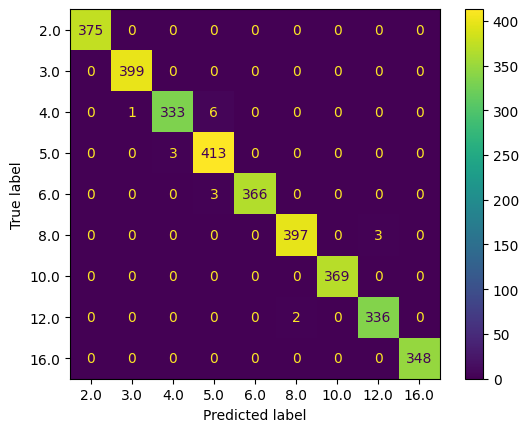

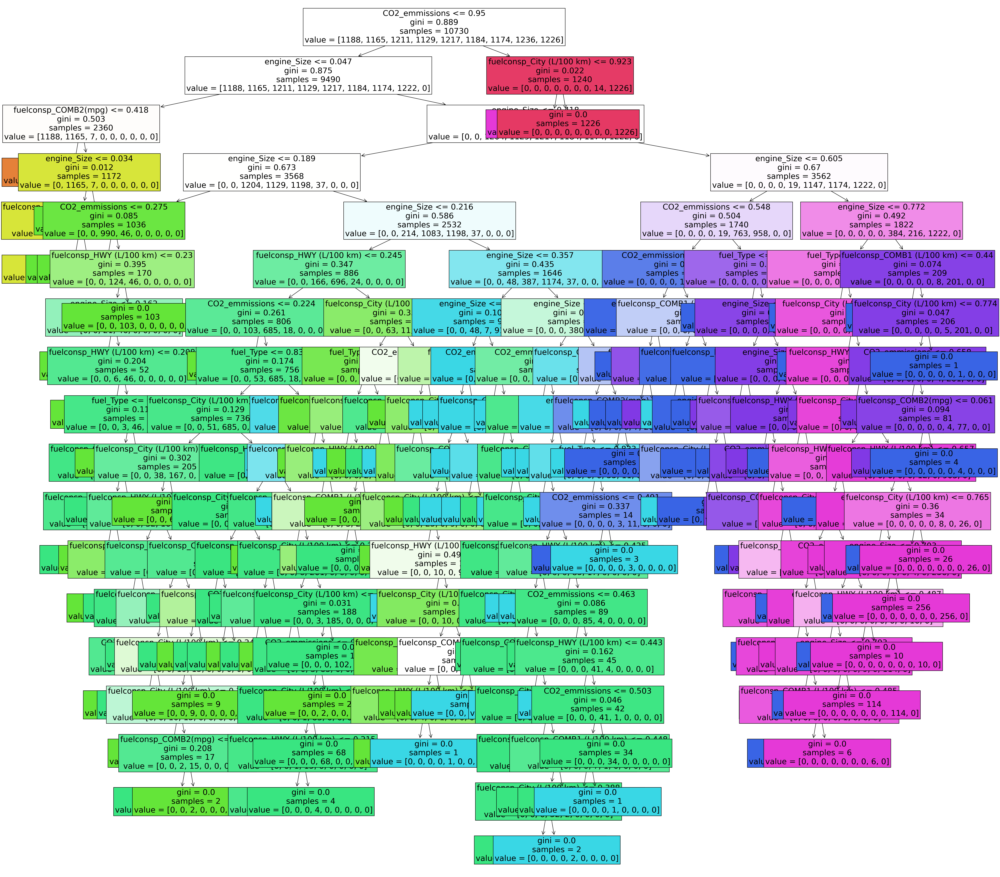

In [105]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled) 
    
    feature_importance=pd.DataFrame(data=model.feature_importances_, index = X.columns, 
             columns = ['Feature_importance']).sort_values('Feature_importance') 
    print(feature_importance) 
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model,X_test_scaled, y_test) 
    
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
    plot_tree(model, feature_names = X.columns, filled = True, fontsize=20 ); 
     
report_model_test(model) 

# KNeighborsClassifier

In [106]:
from sklearn.neighbors import KNeighborsClassifier 

In [107]:
model = KNeighborsClassifier() # instance of the model object

              precision    recall  f1-score   support

         2.0       1.00      1.00      1.00       375
         3.0       1.00      1.00      1.00       399
         4.0       0.98      0.95      0.97       340
         5.0       0.94      0.99      0.97       416
         6.0       0.99      0.96      0.98       369
         8.0       1.00      0.98      0.99       400
        10.0       1.00      1.00      1.00       369
        12.0       0.98      1.00      0.99       338
        16.0       1.00      1.00      1.00       348

    accuracy                           0.99      3354
   macro avg       0.99      0.99      0.99      3354
weighted avg       0.99      0.99      0.99      3354



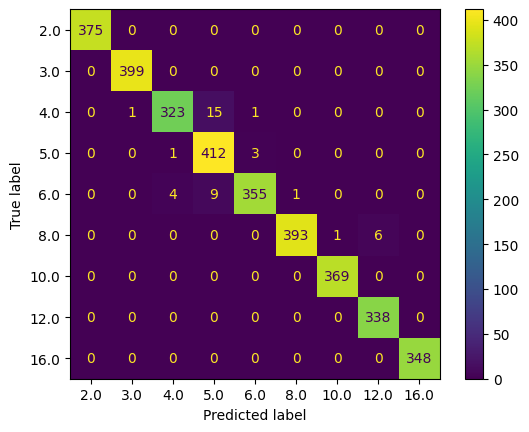

<Figure size 8000x8000 with 0 Axes>

In [108]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

# Support vector machines (svm)

In [109]:
from sklearn.svm import SVC # SVC: support vector classifier

In [110]:
model = SVC() 

              precision    recall  f1-score   support

         2.0       1.00      1.00      1.00       375
         3.0       0.99      1.00      0.99       399
         4.0       0.94      0.72      0.81       340
         5.0       0.72      0.83      0.77       416
         6.0       0.83      0.86      0.84       369
         8.0       0.99      0.83      0.90       400
        10.0       0.91      0.98      0.94       369
        12.0       0.87      0.97      0.92       338
        16.0       1.00      1.00      1.00       348

    accuracy                           0.91      3354
   macro avg       0.92      0.91      0.91      3354
weighted avg       0.92      0.91      0.91      3354



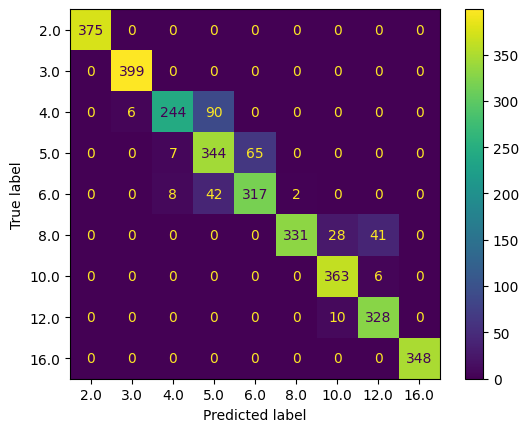

<Figure size 8000x8000 with 0 Axes>

In [111]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

# Random forest

In [112]:
from sklearn.ensemble import RandomForestClassifier 

In [113]:
model = RandomForestClassifier()

              precision    recall  f1-score   support

         2.0       1.00      1.00      1.00       375
         3.0       1.00      1.00      1.00       399
         4.0       1.00      0.99      0.99       340
         5.0       0.99      1.00      0.99       416
         6.0       0.99      0.99      0.99       369
         8.0       0.99      0.99      0.99       400
        10.0       1.00      1.00      1.00       369
        12.0       0.99      0.99      0.99       338
        16.0       1.00      1.00      1.00       348

    accuracy                           1.00      3354
   macro avg       1.00      1.00      1.00      3354
weighted avg       1.00      1.00      1.00      3354



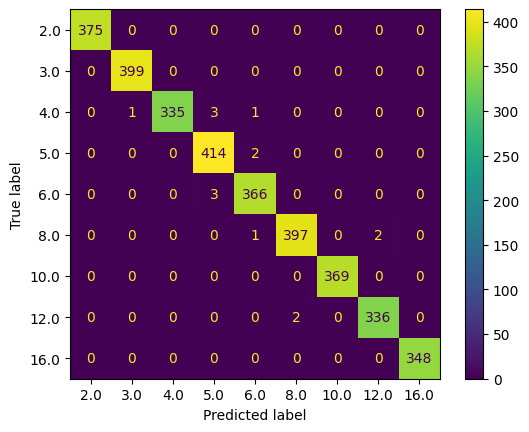

<Figure size 8000x8000 with 0 Axes>

In [114]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

Cross validation - process of using all samples to train and all samples to test

Import the algorithm class from the sklearn i.e., from sklearn.linear_model import LogisticRegression
Instantiate the model i.e., model = LogisticRegression()
Import cross validation from sklearn i.e., from sklearn.model_selection import cross_val_score
Apply cross validation i.e., cross_val_score(estimator=model, X=X_train, y=y_train, cv=5)

In [115]:
from sklearn.linear_model import LogisticRegression 
from sklearn.model_selection import cross_validate, KFold, cross_val_score 
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score 

In [116]:
# Appending several models for cross validation 
models = []  
models.append(("LR",LogisticRegression())) 
models.append(("KNN",KNeighborsClassifier())) 
models.append(("Dtree",DecisionTreeClassifier())) 
models.append(("SVC",SVC())) 
models.append(("RF",RandomForestClassifier()))
 
models 

[('LR', LogisticRegression()),
 ('KNN', KNeighborsClassifier()),
 ('Dtree', DecisionTreeClassifier()),
 ('SVC', SVC()),
 ('RF', RandomForestClassifier())]

In [117]:
def report_cross_val_score(models): 
    for name,model in models: 
        kfold = KFold(n_splits=5) 
        cv_result = cross_val_score(model,X_train,y_train, cv = kfold,scoring = "accuracy") 
        print(name, cv_result) 
        print("Mean is:", name, cv_result.mean()) 
        print("Standard Deviation is:", name, cv_result.std())
             
report_cross_val_score(models) 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stab

LR [0.72646785 0.67008388 0.71295433 0.73485555 0.76048462]
Mean is: LR 0.7209692451071762
Standard Deviation is: LR 0.029792913602653563
KNN [0.95992544 0.96272134 0.95619758 0.95200373 0.97297297]
Mean is: KNN 0.9607642124883504
Standard Deviation is: KNN 0.0070878484032923135
Dtree [0.99673812 0.99394222 0.99534017 0.99114632 0.99534017]
Mean is: Dtree 0.994501397949674
Standard Deviation is: Dtree 0.0018962711975186982
SVC [0.64072693 0.63466915 0.62954334 0.65517241 0.64771668]
Mean is: SVC 0.6415657036346691
Standard Deviation is: SVC 0.00911899525248653
RF [0.9944082  0.9972041  0.99627213 0.99627213 0.99534017]
Mean is: RF 0.9958993476234855
Standard Deviation is: RF 0.0009504230221049063


KNN, Dtree and random forest performed well while decision tree has the best performance of 0.993

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LR
              precision    recall  f1-score   support

         2.0       0.97      1.00      0.98       375
         3.0       0.95      1.00      0.98       399
         4.0       0.65      0.78      0.71       340
         5.0       0.64      0.35      0.45       416
         6.0       0.64      0.82      0.72       369
         8.0       0.94      0.74      0.83       400
        10.0       0.81      0.83      0.82       369
        12.0       0.78      0.91      0.84       338
        16.0       0.97      1.00      0.99       348

    accuracy                           0.82      3354
   macro avg       0.82      0.82      0.81      3354
weighted avg       0.82      0.82      0.81      3354



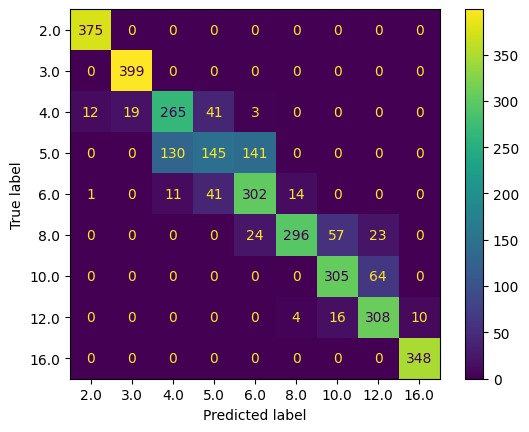

KNN
              precision    recall  f1-score   support

         2.0       1.00      1.00      1.00       375
         3.0       1.00      1.00      1.00       399
         4.0       0.98      0.95      0.97       340
         5.0       0.94      0.99      0.97       416
         6.0       0.99      0.96      0.98       369
         8.0       1.00      0.98      0.99       400
        10.0       1.00      1.00      1.00       369
        12.0       0.98      1.00      0.99       338
        16.0       1.00      1.00      1.00       348

    accuracy                           0.99      3354
   macro avg       0.99      0.99      0.99      3354
weighted avg       0.99      0.99      0.99      3354



<Figure size 8000x8000 with 0 Axes>

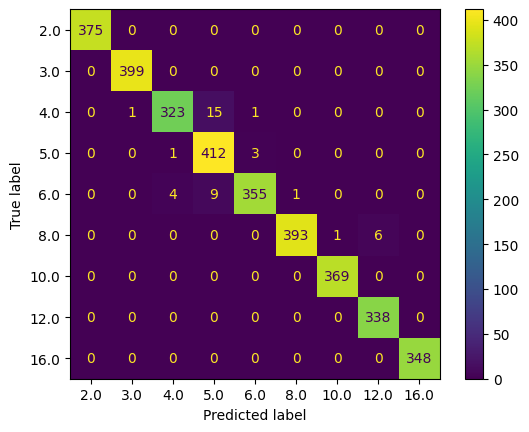

Dtree
              precision    recall  f1-score   support

         2.0       1.00      1.00      1.00       375
         3.0       1.00      1.00      1.00       399
         4.0       0.99      0.98      0.99       340
         5.0       0.98      0.99      0.99       416
         6.0       1.00      0.99      1.00       369
         8.0       0.99      0.99      0.99       400
        10.0       1.00      1.00      1.00       369
        12.0       0.99      0.99      0.99       338
        16.0       1.00      1.00      1.00       348

    accuracy                           0.99      3354
   macro avg       1.00      0.99      0.99      3354
weighted avg       0.99      0.99      0.99      3354



<Figure size 8000x8000 with 0 Axes>

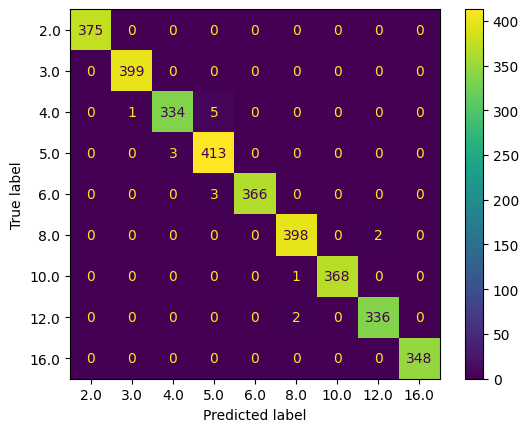

SVC
              precision    recall  f1-score   support

         2.0       1.00      1.00      1.00       375
         3.0       0.99      1.00      0.99       399
         4.0       0.94      0.72      0.81       340
         5.0       0.72      0.83      0.77       416
         6.0       0.83      0.86      0.84       369
         8.0       0.99      0.83      0.90       400
        10.0       0.91      0.98      0.94       369
        12.0       0.87      0.97      0.92       338
        16.0       1.00      1.00      1.00       348

    accuracy                           0.91      3354
   macro avg       0.92      0.91      0.91      3354
weighted avg       0.92      0.91      0.91      3354



<Figure size 8000x8000 with 0 Axes>

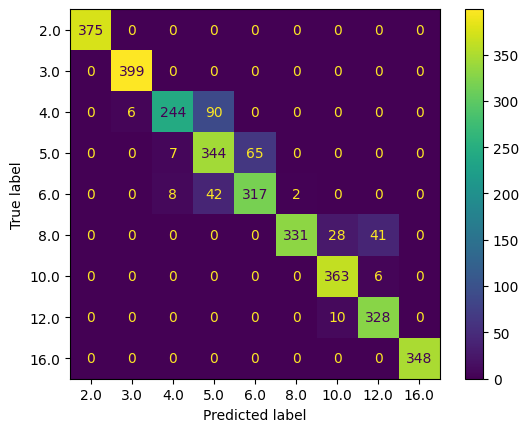

RF
              precision    recall  f1-score   support

         2.0       1.00      1.00      1.00       375
         3.0       1.00      1.00      1.00       399
         4.0       1.00      0.98      0.99       340
         5.0       0.98      1.00      0.99       416
         6.0       0.99      0.99      0.99       369
         8.0       0.99      0.99      0.99       400
        10.0       1.00      1.00      1.00       369
        12.0       0.99      0.99      0.99       338
        16.0       1.00      1.00      1.00       348

    accuracy                           1.00      3354
   macro avg       1.00      1.00      1.00      3354
weighted avg       1.00      1.00      1.00      3354



<Figure size 8000x8000 with 0 Axes>

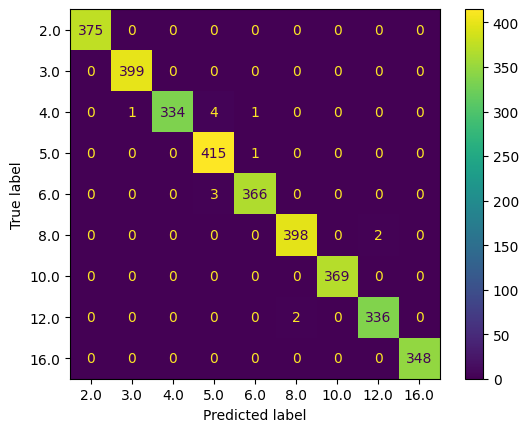

<Figure size 8000x8000 with 0 Axes>

In [118]:
# The model test report 
def report_model_test(models): 
    for name,model in models: 
        model.fit(X_train_scaled,y_train) 
        basem_preds = model.predict(X_test_scaled) 
        print(name) 
        print(classification_report(y_test,basem_preds))
        ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test) 
        plt.show() 
        plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(models) 

# Hyperparameter tuning using GridSearchCV

In [119]:
from sklearn.model_selection import GridSearchCV # importing GridSearchCV  

In [120]:
model = LogisticRegression() # instiatiate the model 

In [121]:
grid_param = { 
    'solver':['newton-cg', 'lbfgs', 'liblinear', 'sag', 'saga'], 
    'penalty':['l1', 'l2', 'elasticnet', 'none'] 
} # declaring the parameter to tune with  

In [122]:
gd_lr = GridSearchCV(estimator=model, 
                     param_grid=grid_param, 
                     scoring='accuracy', 
                     cv=5, 
                     n_jobs=-1) # instantiating an object of GridSearchCV 

In [123]:
# gd_lr.fit(X_train_scaled, y_train) # fitting the object 

In [124]:
# gd_lr.best_estimator_

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


              precision    recall  f1-score   support

         2.0       0.97      1.00      0.98       375
         3.0       0.95      1.00      0.98       399
         4.0       0.65      0.78      0.71       340
         5.0       0.64      0.35      0.45       416
         6.0       0.64      0.82      0.72       369
         8.0       0.94      0.74      0.83       400
        10.0       0.81      0.83      0.82       369
        12.0       0.78      0.91      0.84       338
        16.0       0.97      1.00      0.99       348

    accuracy                           0.82      3354
   macro avg       0.82      0.82      0.81      3354
weighted avg       0.82      0.82      0.81      3354



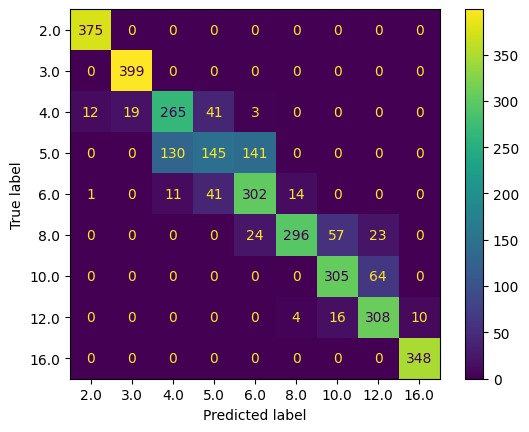

<Figure size 8000x8000 with 0 Axes>

In [125]:
# Training and evaluating the grid model 
def report_model_test(gd_lr): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(gd_lr) # using the gridsearch model to predict 

After hyperparameter tuning logistic regression improved. Hence all models should be tuned and the best selected.

Explore on your own how tuning of decision tree, support vector machines, and K nearestNeighbor affects theirresult.
Saving your model



In [126]:
import joblib 
# Fit the model on training set 
model = LogisticRegression(penalty= 'none', solver= 'newton-cg') 
model.fit(X_train_scaled, y_train) 
# save the model to disk 
filename = 'finalized_model.sav' 
joblib.dump(model, filename) 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:1173: FutureWarning: `penalty='none'`has been deprecated in 1.2 and will be removed in 1.4. To keep the past behaviour, set `penalty=None`.
  warnings.warn(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\utils\optimize.py:210: ConvergenceWarning: newton-cg failed to converge. Increase the number of iterations.
  warnings.warn(


['finalized_model.sav']

# Load the model from disk¶

              precision    recall  f1-score   support

         2.0       1.00      1.00      1.00       375
         3.0       1.00      1.00      1.00       399
         4.0       0.91      0.88      0.89       340
         5.0       0.74      0.66      0.70       416
         6.0       0.73      0.83      0.78       369
         8.0       0.96      0.85      0.90       400
        10.0       0.75      0.85      0.80       369
        12.0       0.83      0.83      0.83       338
        16.0       1.00      1.00      1.00       348

    accuracy                           0.87      3354
   macro avg       0.88      0.88      0.88      3354
weighted avg       0.88      0.87      0.87      3354



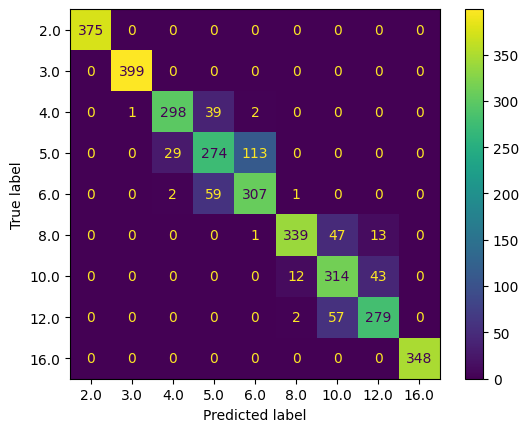

<Figure size 8000x8000 with 0 Axes>

In [127]:
loaded_model = joblib.load(filename) 
model = loaded_model 
 
# The model test report 
def report_model_test(model): 
     
    basem_preds = model.predict(X_test_scaled) 
           
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

Explore on your own how to create a pipeline and deploy your model

Explore how to use ROC,AUC,Precision and Recall Curves

Explore tuning other algorithms and observe the results.

# Second Target: Fuel Type

In [128]:
fuel_leb_df.info() # confirming the dataset

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5359 entries, 0 to 5358
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   model_Year                  5359 non-null   int32  
 1   engine_Size                 5359 non-null   float64
 2   cylinder                    5359 non-null   float64
 3   fuelconsp_City (L/100 km)   5359 non-null   float64
 4   fuelconsp_HWY (L/100 km)    5359 non-null   float64
 5   fuelconsp_COMB1 (L/100 km)  5359 non-null   float64
 6   fuelconsp_COMB2(mpg)        5359 non-null   float64
 7   CO2_emmissions              5359 non-null   int32  
 8   fuel_Type                   5359 non-null   int32  
dtypes: float64(6), int32(3)
memory usage: 314.1 KB


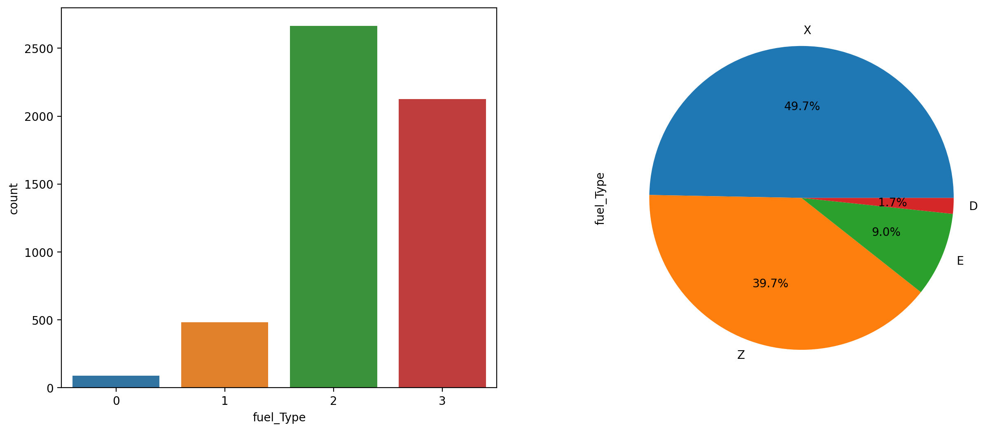

In [129]:
# balancing


fig, ax_position=plt.subplots(1,2,figsize=(15,6),dpi=200) # creates the framework for the plotting 
a = sns.countplot(x='fuel_Type', data=fuel_leb_df, ax=ax_position[0]) #ax_position[0] specifies plot to be in index 0 
a= df['fuel_Type'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax_position[1]) #ax_position[1] specifies plot to be in index 1 

In [130]:
# balancing the target variable for efficient machine learning
X = fuel_leb_df.drop('fuel_Type', axis = 1) 
y = fuel_leb_df['fuel_Type']

# Applying smote

In [131]:
from imblearn.over_sampling import SMOTE 
sm = SMOTE(random_state=42, k_neighbors = 2) # The object is created  
X_res, y_res = sm.fit_resample(X, y) # The object is applied 
X, y = X_res, y_res # reassigning the balanced dataset to X,y

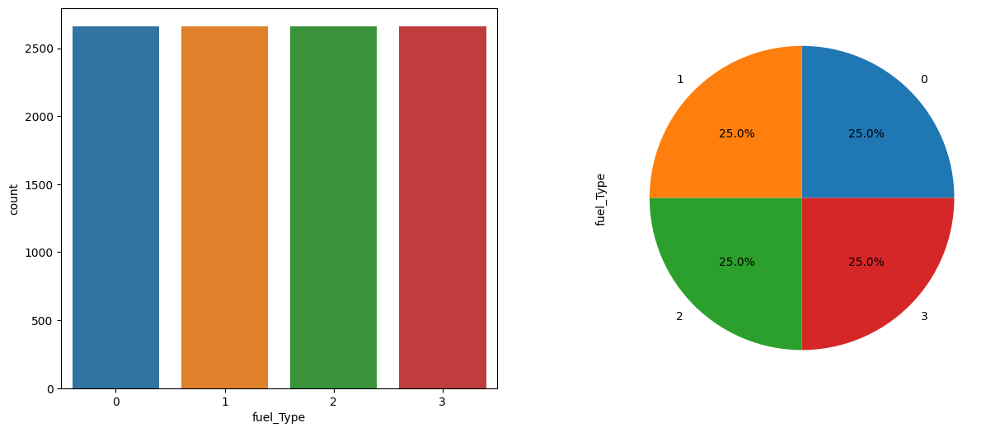

In [132]:
# Plot of the dataset   
df_bal = pd.concat([X_res,y_res], axis = 1) # creating a dataframe for the balanced data 
fig, ax=plt.subplots(1,2,figsize=(15,6)) # creating the axis shell for subplot 
a = sns.countplot(x='fuel_Type',data=df_bal,  ax=ax[0]) # assigning each of the plot to the axis shell 
a= df_bal['fuel_Type'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax[1]) # assigning each of the plot to the axis shell 

In [133]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) 
 
X,y=X_train,y_train 
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42) 

In [134]:
#Scaling the dataset
scaler = MinMaxScaler() 
X_train_scaled = scaler.fit_transform(X_train) 
X_test_scaled = scaler.transform(X_test) 
X_val_scaled = scaler.transform(X_val) 

# Logistic regression

In [135]:
model = LogisticRegression() 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


              precision    recall  f1-score   support

           0       0.94      1.00      0.97       534
           1       1.00      0.99      1.00       526
           2       0.62      0.60      0.61       520
           3       0.66      0.64      0.65       551

    accuracy                           0.81      2131
   macro avg       0.80      0.81      0.81      2131
weighted avg       0.80      0.81      0.81      2131



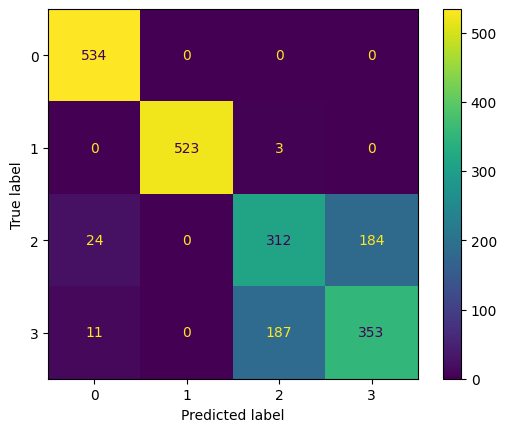

<Figure size 8000x8000 with 0 Axes>

In [136]:
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model)

in the first fuel type, 534 is the predicted label

in the second fuel type, 523 is predicted; one is mis-calculated

in the third fuel type, 314 is predicted; 23 and 0 are mis-calculated

in the fourth fuel type, 352 is used; 11 and 188 are mis-calculated

# Decision tree model

In [137]:
model = DecisionTreeClassifier() 

                            Feature_importance
fuelconsp_COMB2(mpg)                  0.006243
model_Year                            0.017723
cylinder                              0.050535
fuelconsp_COMB1 (L/100 km)            0.117352
CO2_emmissions                        0.156129
fuelconsp_HWY (L/100 km)              0.168218
engine_Size                           0.188812
fuelconsp_City (L/100 km)             0.294987
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       534
           1       1.00      1.00      1.00       526
           2       0.90      0.91      0.91       520
           3       0.92      0.90      0.91       551

    accuracy                           0.95      2131
   macro avg       0.95      0.95      0.95      2131
weighted avg       0.95      0.95      0.95      2131



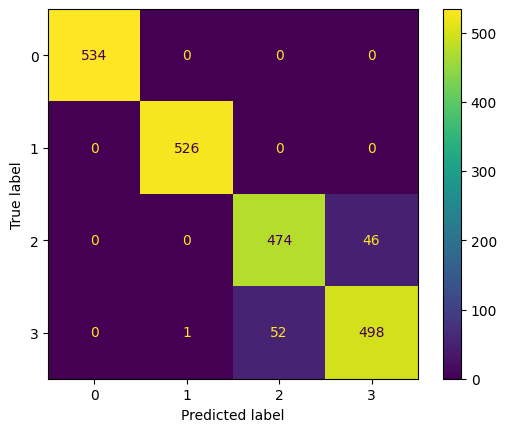

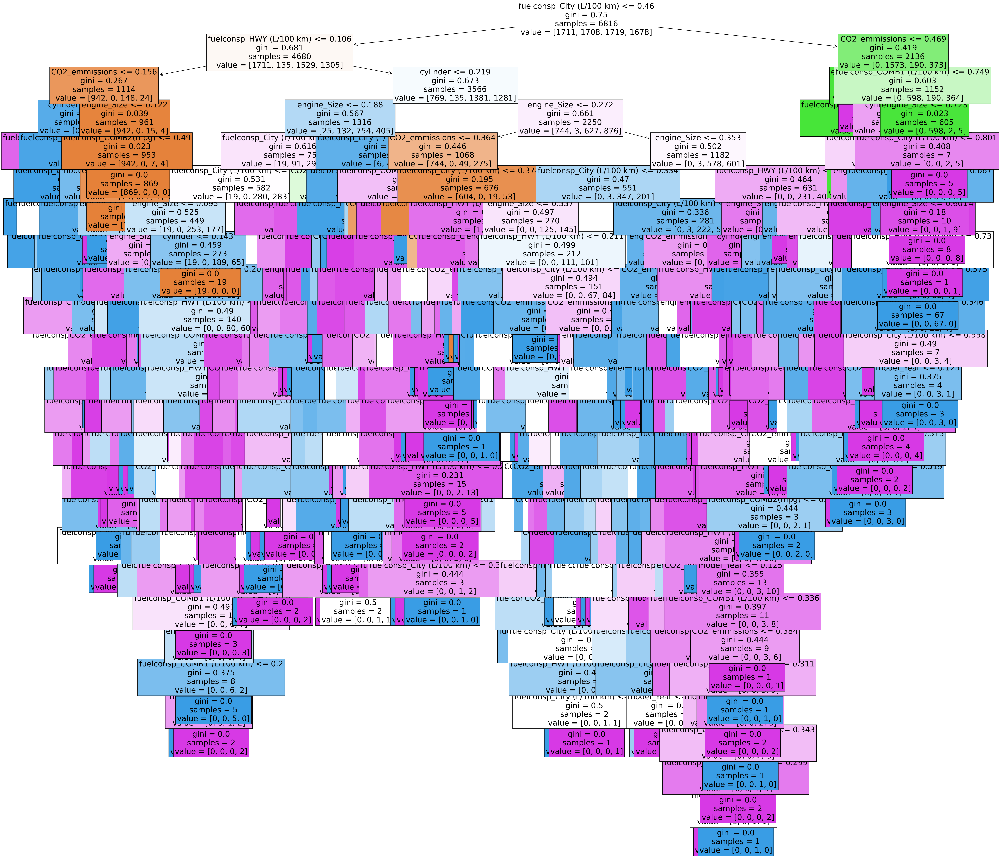

In [138]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled) 
    
    feature_importance=pd.DataFrame(data=model.feature_importances_, index = X.columns, 
             columns = ['Feature_importance']).sort_values('Feature_importance') 
    print(feature_importance) 
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model,X_test_scaled, y_test) 
    
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
    plot_tree(model, feature_names = X.columns, filled = True, fontsize=20 ); 
     
report_model_test(model) 

# KNeighborsClassifier

In [139]:
model = KNeighborsClassifier() # instance of the model object

              precision    recall  f1-score   support

           0       0.99      1.00      0.99       534
           1       1.00      1.00      1.00       526
           2       0.81      0.80      0.81       520
           3       0.81      0.82      0.82       551

    accuracy                           0.90      2131
   macro avg       0.90      0.90      0.90      2131
weighted avg       0.90      0.90      0.90      2131



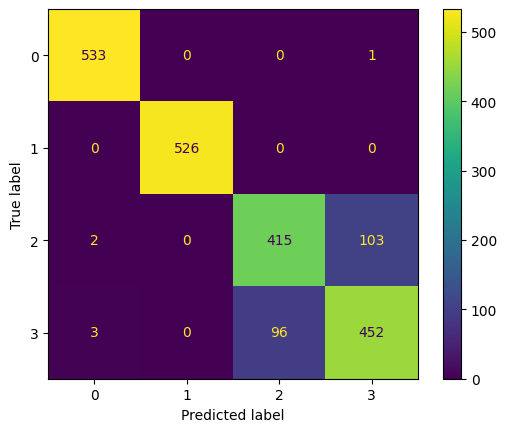

<Figure size 8000x8000 with 0 Axes>

In [140]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model)

# Support vector machines (svm

In [141]:
from sklearn.svm import SVC # SVC: support vector classifier  
model = SVC()

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       534
           1       1.00      1.00      1.00       526
           2       0.65      0.67      0.66       520
           3       0.68      0.66      0.67       551

    accuracy                           0.83      2131
   macro avg       0.83      0.83      0.83      2131
weighted avg       0.83      0.83      0.83      2131



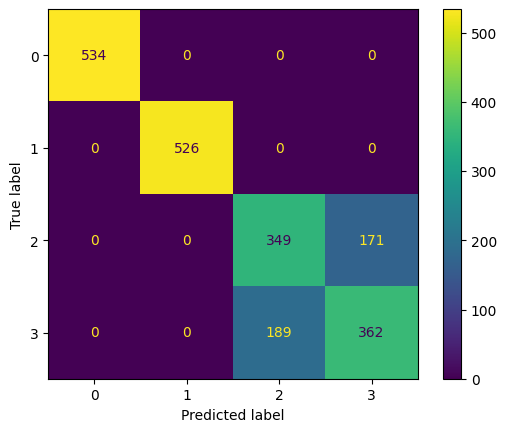

<Figure size 8000x8000 with 0 Axes>

In [142]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

# Random forest

In [143]:
from sklearn.ensemble import RandomForestClassifier 
model = RandomForestClassifier()

              precision    recall  f1-score   support

           0       1.00      1.00      1.00       534
           1       1.00      1.00      1.00       526
           2       0.92      0.92      0.92       520
           3       0.92      0.92      0.92       551

    accuracy                           0.96      2131
   macro avg       0.96      0.96      0.96      2131
weighted avg       0.96      0.96      0.96      2131



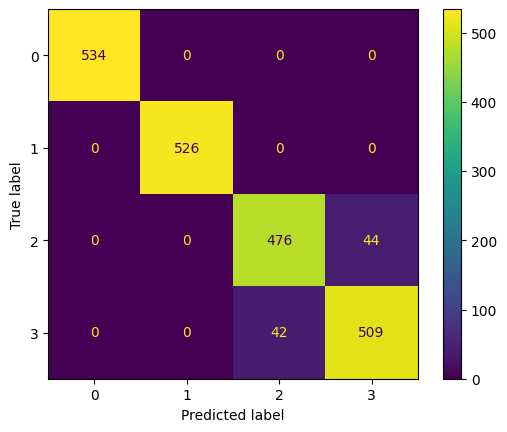

<Figure size 8000x8000 with 0 Axes>

In [144]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

# cross validation of the mode

In [145]:
from sklearn.linear_model import LogisticRegression 
from sklearn.model_selection import cross_validate, KFold, cross_val_score 
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score 

In [146]:
# Appending several models for cross validation 
models = []  
models.append(("LR",LogisticRegression())) 
models.append(("KNN",KNeighborsClassifier())) 
models.append(("Dtree",DecisionTreeClassifier())) 
models.append(("SVC",SVC())) 
models.append(("RF",RandomForestClassifier()))
 
models 

[('LR', LogisticRegression()),
 ('KNN', KNeighborsClassifier()),
 ('Dtree', DecisionTreeClassifier()),
 ('SVC', SVC()),
 ('RF', RandomForestClassifier())]

In [147]:
def report_cross_val_score(models): 
    for name,model in models: 
        kfold = KFold(n_splits=5) 
        cv_result = cross_val_score(model,X_train,y_train, cv = kfold,scoring = "accuracy") 
        print(name, cv_result) 
        print("Mean is:", name, cv_result.mean()) 
        print("Standard Deviation is:", name, cv_result.std())
             
report_cross_val_score(models) 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stab

LR [0.76392962 0.7916361  0.79310345 0.76595745 0.76669112]
Mean is: LR 0.7762635466443479
Standard Deviation is: LR 0.013189923129848126
KNN [0.87536657 0.85619956 0.86867205 0.87234043 0.86647102]
Mean is: KNN 0.8678099242011864
Standard Deviation is: KNN 0.00655690176693397
Dtree [0.9340176  0.94497432 0.95524578 0.93837124 0.95084373]
Mean is: Dtree 0.9446905330014221
Standard Deviation is: Dtree 0.0077871774767738645
SVC [0.35997067 0.33675715 0.34556126 0.36390315 0.37784299]
Mean is: SVC 0.3568070475899506
Standard Deviation is: SVC 0.014362034977965602
RF [0.94354839 0.9486427  0.95451211 0.94790902 0.95597946]
Mean is: RF 0.9501183347927957
Standard Deviation is: RF 0.00455808602457043


c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LR
              precision    recall  f1-score   support

           0       0.94      1.00      0.97       534
           1       1.00      0.99      1.00       526
           2       0.62      0.60      0.61       520
           3       0.66      0.64      0.65       551

    accuracy                           0.81      2131
   macro avg       0.80      0.81      0.81      2131
weighted avg       0.80      0.81      0.81      2131



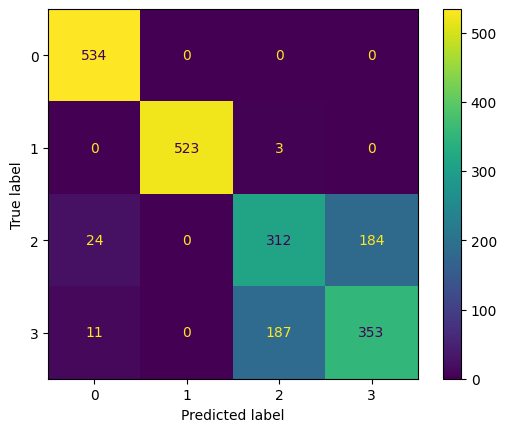

KNN
              precision    recall  f1-score   support

           0       0.99      1.00      0.99       534
           1       1.00      1.00      1.00       526
           2       0.81      0.80      0.81       520
           3       0.81      0.82      0.82       551

    accuracy                           0.90      2131
   macro avg       0.90      0.90      0.90      2131
weighted avg       0.90      0.90      0.90      2131



<Figure size 8000x8000 with 0 Axes>

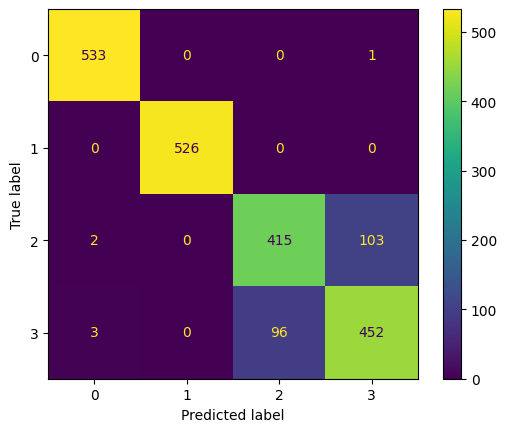

Dtree
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       534
           1       1.00      1.00      1.00       526
           2       0.91      0.91      0.91       520
           3       0.92      0.91      0.91       551

    accuracy                           0.96      2131
   macro avg       0.96      0.96      0.96      2131
weighted avg       0.96      0.96      0.96      2131



<Figure size 8000x8000 with 0 Axes>

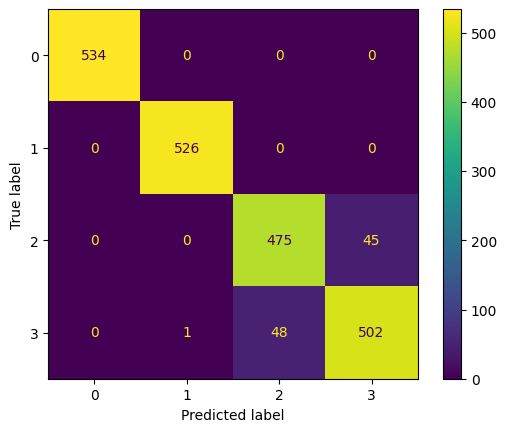

SVC
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       534
           1       1.00      1.00      1.00       526
           2       0.65      0.67      0.66       520
           3       0.68      0.66      0.67       551

    accuracy                           0.83      2131
   macro avg       0.83      0.83      0.83      2131
weighted avg       0.83      0.83      0.83      2131



<Figure size 8000x8000 with 0 Axes>

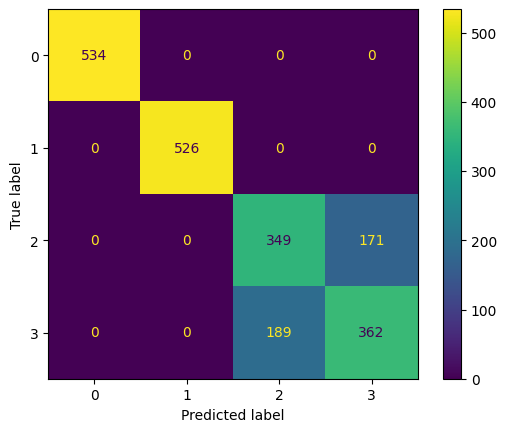

RF
              precision    recall  f1-score   support

           0       1.00      1.00      1.00       534
           1       1.00      1.00      1.00       526
           2       0.92      0.91      0.92       520
           3       0.92      0.93      0.92       551

    accuracy                           0.96      2131
   macro avg       0.96      0.96      0.96      2131
weighted avg       0.96      0.96      0.96      2131



<Figure size 8000x8000 with 0 Axes>

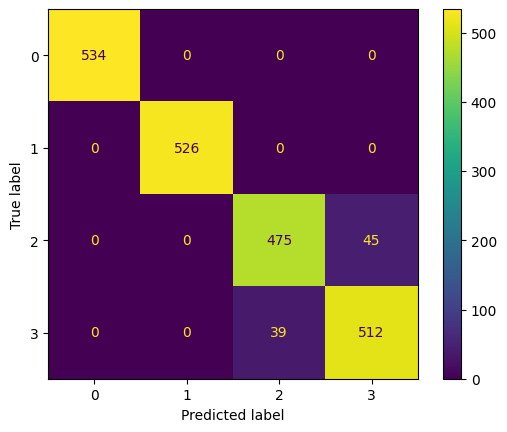

<Figure size 8000x8000 with 0 Axes>

In [148]:
# The model test report 
def report_model_test(models): 
    for name,model in models: 
        model.fit(X_train_scaled,y_train) 
        basem_preds = model.predict(X_test_scaled) 
        print(name) 
        print(classification_report(y_test,basem_preds))
        ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test) 
        plt.show() 
        plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(models) 

# Third Target: Transmission

In [149]:
trans_leb_df.info() # Checking the details of the dataset

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5359 entries, 0 to 5358
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   model_Year                  5359 non-null   int32  
 1   engine_Size                 5359 non-null   float64
 2   cylinder                    5359 non-null   float64
 3   fuelconsp_City (L/100 km)   5359 non-null   float64
 4   fuelconsp_HWY (L/100 km)    5359 non-null   float64
 5   fuelconsp_COMB1 (L/100 km)  5359 non-null   float64
 6   fuelconsp_COMB2(mpg)        5359 non-null   float64
 7   CO2_emmissions              5359 non-null   int32  
 8   transmission                5359 non-null   int32  
dtypes: float64(6), int32(3)
memory usage: 314.1 KB


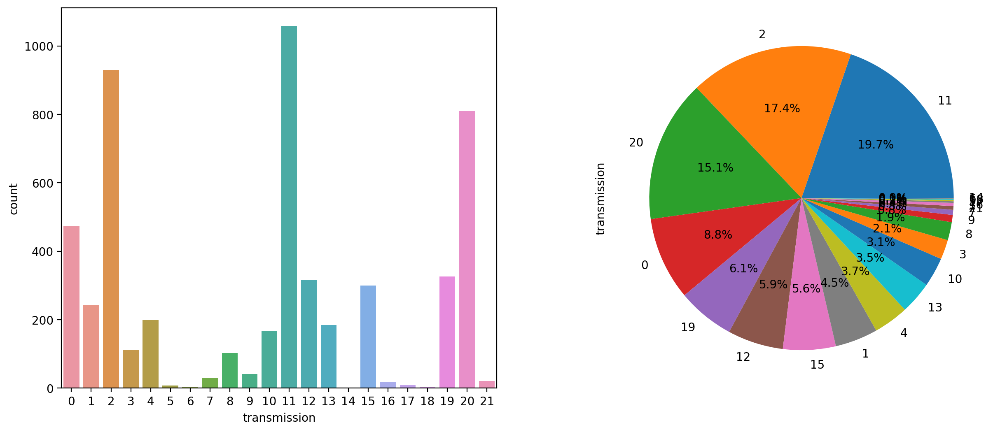

In [150]:
# balancing
fig, ax_position=plt.subplots(1,2,figsize=(15,6),dpi=200) # creates the framework for the plotting 
a = sns.countplot(x='transmission', data=trans_leb_df, ax=ax_position[0]) #ax_position[0] specifies plot to be in index 0 
a= trans_leb_df['transmission'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax_position[1]) #ax_position[1] specifies plot to be in index 1 

In [151]:
from sklearn.model_selection import train_test_split 
from sklearn.preprocessing import MinMaxScaler

In [152]:
# balancing the target variable for efficient machine learning
X = trans_leb_df.drop('transmission', axis = 1) 
y = trans_leb_df['transmission']

In [153]:
# Applying smote
from imblearn.over_sampling import SMOTE 
sm = SMOTE(random_state=42, k_neighbors = 1) # The object is created  
X_res, y_res = sm.fit_resample(X, y) # The object is applied 
X, y = X_res, y_res # reassigning the balanced dataset to X,y

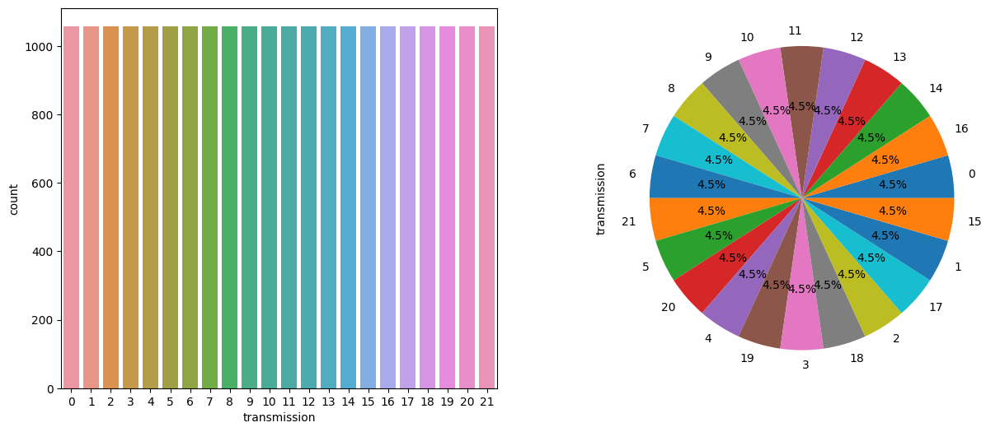

In [154]:
# Plot of the dataset   
df_bal = pd.concat([X_res,y_res], axis = 1) # creating a dataframe for the balanced data 
fig, ax=plt.subplots(1,2,figsize=(15,6)) # creating the axis shell for subplot 
a = sns.countplot(x='transmission',data=df_bal,  ax=ax[0]) # assigning each of the plot to the axis shell 
a= df_bal['transmission'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax[1]) # assigning each of the plot to the axis shell 

In [155]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) 
 
X,y=X_train,y_train 
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42) 

In [156]:
# scaling the dataset
scaler = MinMaxScaler() 
X_train_scaled = scaler.fit_transform(X_train) 
X_test_scaled = scaler.transform(X_test) 
X_val_scaled = scaler.transform(X_val) 

In [157]:
# logistic regression
model = LogisticRegression() 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


              precision    recall  f1-score   support

           0       0.40      0.45      0.42       202
           1       0.22      0.14      0.17       218
           2       0.36      0.21      0.26       207
           3       0.22      0.27      0.24       214
           4       0.37      0.19      0.25       243
           5       0.43      0.95      0.59       190
           6       0.96      1.00      0.98       204
           7       0.40      0.33      0.37       221
           8       0.15      0.07      0.10       210
           9       0.40      0.71      0.51       198
          10       0.15      0.19      0.17       195
          11       0.00      0.00      0.00       226
          12       0.28      0.20      0.23       240
          13       0.06      0.04      0.04       214
          14       0.62      1.00      0.77       223
          15       0.58      0.29      0.39       207
          16       0.45      0.84      0.59       212
          17       0.58    

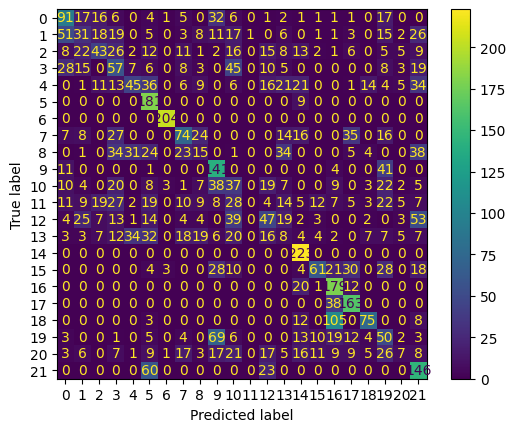

<Figure size 8000x8000 with 0 Axes>

In [158]:
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model)

In [159]:
# decision tree
model = DecisionTreeClassifier() 

                            Feature_importance
fuelconsp_COMB2(mpg)                  0.015114
cylinder                              0.051580
fuelconsp_COMB1 (L/100 km)            0.081563
model_Year                            0.087793
CO2_emmissions                        0.103950
fuelconsp_City (L/100 km)             0.181038
fuelconsp_HWY (L/100 km)              0.200786
engine_Size                           0.278175
              precision    recall  f1-score   support

           0       0.90      0.93      0.91       202
           1       0.90      0.91      0.90       218
           2       0.74      0.74      0.74       207
           3       0.94      0.92      0.93       214
           4       0.89      0.91      0.90       243
           5       0.98      1.00      0.99       190
           6       1.00      1.00      1.00       204
           7       0.96      0.99      0.98       221
           8       0.95      0.96      0.96       210
           9       0.96      0.97   

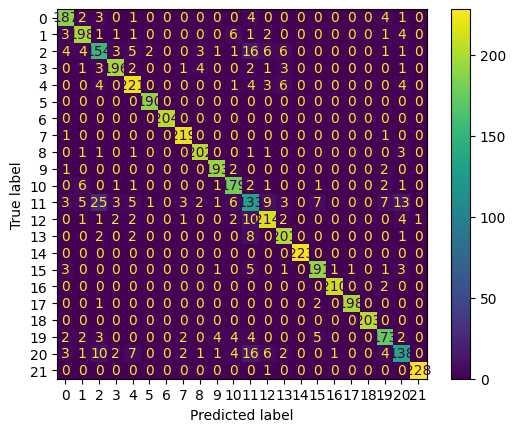

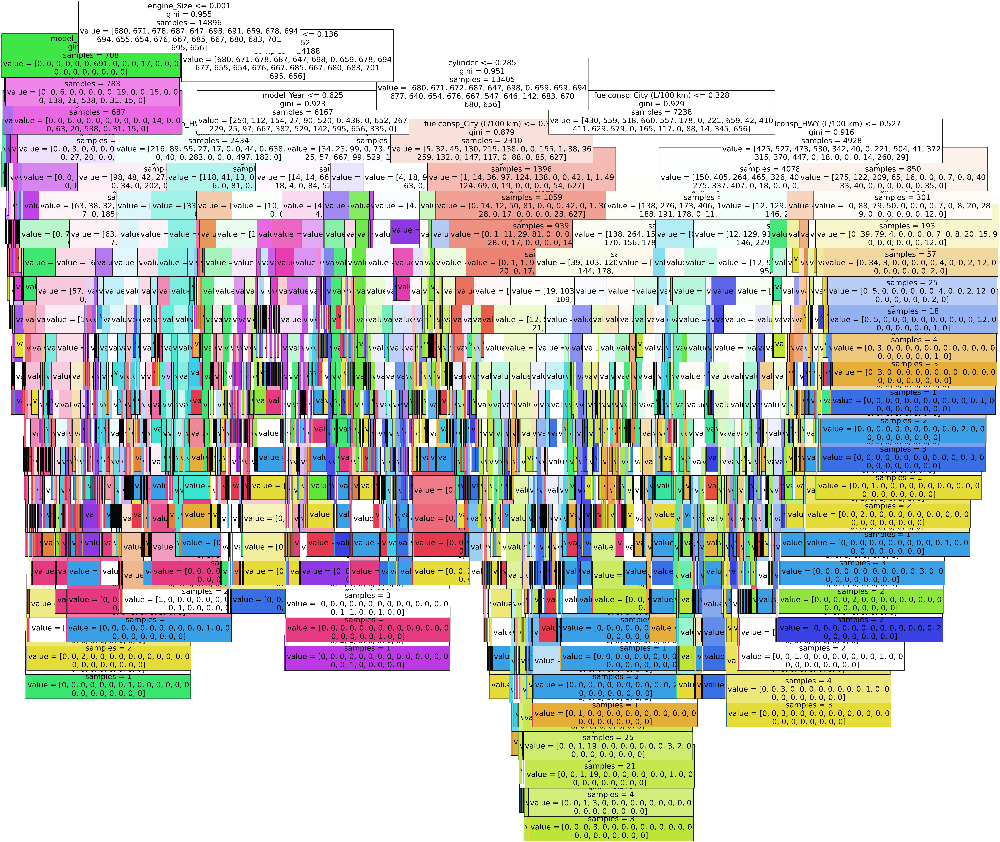

In [160]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled) 
    
    feature_importance=pd.DataFrame(data=model.feature_importances_, index = X.columns, 
             columns = ['Feature_importance']).sort_values('Feature_importance') 
    print(feature_importance) 
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model,X_test_scaled, y_test) 
    
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
    plot_tree(model, feature_names = X.columns, filled = True, fontsize=20 ); 
     
report_model_test(model) 

In [161]:
# KNeighborsClassifier 
from sklearn.neighbors import KNeighborsClassifier 

In [162]:
model = KNeighborsClassifier() # instance of the model object

              precision    recall  f1-score   support

           0       0.71      0.80      0.75       202
           1       0.69      0.82      0.75       218
           2       0.53      0.46      0.49       207
           3       0.83      0.91      0.87       214
           4       0.84      0.90      0.87       243
           5       0.96      1.00      0.98       190
           6       1.00      1.00      1.00       204
           7       0.90      1.00      0.95       221
           8       0.85      0.96      0.90       210
           9       0.91      0.98      0.95       198
          10       0.74      0.93      0.82       195
          11       0.46      0.18      0.26       226
          12       0.80      0.69      0.74       240
          13       0.86      0.92      0.88       214
          14       1.00      1.00      1.00       223
          15       0.84      0.83      0.83       207
          16       0.96      1.00      0.98       212
          17       0.98    

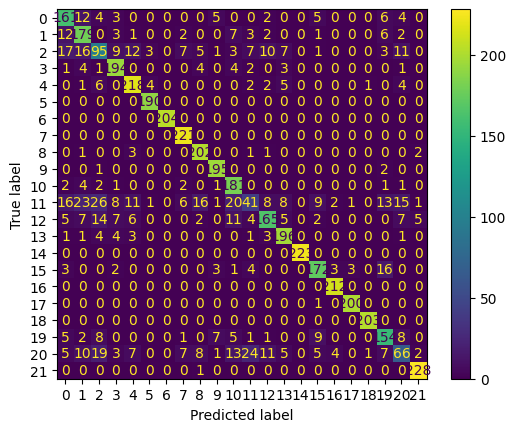

<Figure size 8000x8000 with 0 Axes>

In [163]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

In [164]:
# Support vector machines (svm)
from sklearn.svm import SVC # SVC: support vector classifier  
model = SVC()

              precision    recall  f1-score   support

           0       0.65      0.51      0.58       202
           1       0.39      0.36      0.38       218
           2       0.46      0.21      0.29       207
           3       0.29      0.56      0.38       214
           4       0.44      0.17      0.25       243
           5       0.64      1.00      0.78       190
           6       1.00      1.00      1.00       204
           7       0.59      0.62      0.60       221
           8       0.35      0.44      0.39       210
           9       0.46      0.78      0.58       198
          10       0.37      0.28      0.32       195
          11       1.00      0.00      0.01       226
          12       0.38      0.25      0.30       240
          13       0.48      0.42      0.44       214
          14       0.92      1.00      0.96       223
          15       0.86      0.42      0.56       207
          16       0.75      0.76      0.75       212
          17       0.79    

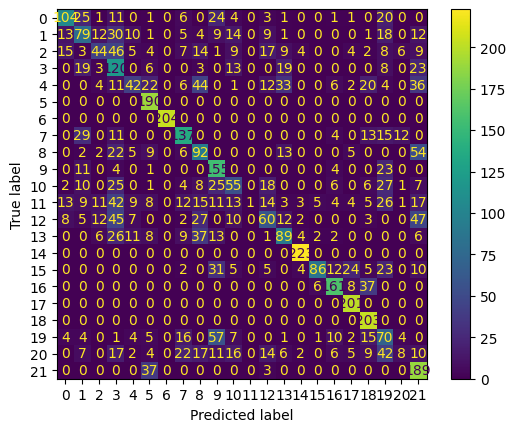

<Figure size 8000x8000 with 0 Axes>

In [165]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

In [166]:
# Random forest
from sklearn.ensemble import RandomForestClassifier 
model = RandomForestClassifier()

              precision    recall  f1-score   support

           0       0.92      0.96      0.94       202
           1       0.93      0.96      0.95       218
           2       0.80      0.74      0.77       207
           3       0.97      0.95      0.96       214
           4       0.93      0.96      0.94       243
           5       0.98      1.00      0.99       190
           6       1.00      1.00      1.00       204
           7       0.97      1.00      0.98       221
           8       0.96      0.99      0.97       210
           9       0.98      0.98      0.98       198
          10       0.93      0.96      0.94       195
          11       0.72      0.59      0.65       226
          12       0.88      0.93      0.90       240
          13       0.96      0.99      0.97       214
          14       1.00      1.00      1.00       223
          15       0.96      0.96      0.96       207
          16       1.00      1.00      1.00       212
          17       0.99    

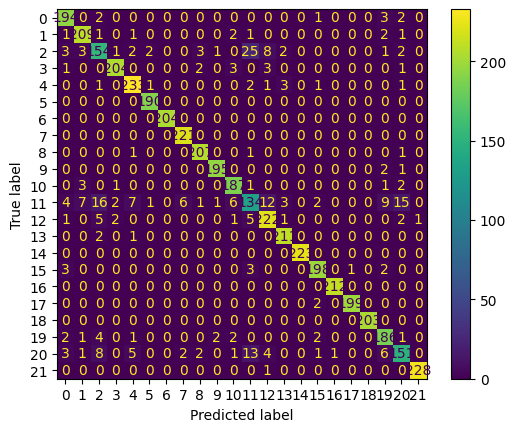

<Figure size 8000x8000 with 0 Axes>

In [167]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model)

In [168]:
# cross validation of the model
from sklearn.linear_model import LogisticRegression 
from sklearn.model_selection import cross_validate, KFold, cross_val_score 
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score 

In [169]:
# Appending several models for cross validation 
models = []  
models.append(("LR",LogisticRegression())) 
models.append(("KNN",KNeighborsClassifier())) 
models.append(("Dtree",DecisionTreeClassifier())) 
models.append(("SVC",SVC())) 
models.append(("RF",RandomForestClassifier()))
 
models 

[('LR', LogisticRegression()),
 ('KNN', KNeighborsClassifier()),
 ('Dtree', DecisionTreeClassifier()),
 ('SVC', SVC()),
 ('RF', RandomForestClassifier())]

In [170]:
def report_cross_val_score(models): 
    for name,model in models: 
        kfold = KFold(n_splits=5) 
        cv_result = cross_val_score(model,X_train,y_train, cv = kfold,scoring = "accuracy") 
        print(name, cv_result) 
        print("Mean is:", name, cv_result.mean()) 
        print("Standard Deviation is:", name, cv_result.std())
             
report_cross_val_score(models)

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stab

LR [0.24597315 0.15206445 0.24202753 0.14971467 0.18429003]
Mean is: LR 0.19481396621991526
Standard Deviation is: LR 0.04199667511854583
KNN [0.8261745  0.83316549 0.82611615 0.8190668  0.83517959]
Mean is: KNN 0.8279405052368819
Standard Deviation is: KNN 0.005742726511219156
Dtree [0.90503356 0.91305807 0.90164485 0.91305807 0.90701578]
Mean is: Dtree 0.9079620655550824
Standard Deviation is: Dtree 0.004501498822601177
SVC [0.10067114 0.12017456 0.11614636 0.09835515 0.1332662 ]
Mean is: SVC 0.11372268068875868
Standard Deviation is: SVC 0.01293022443411397
RF [0.92315436 0.92816381 0.9284995  0.9305136  0.92782813]
Mean is: RF 0.9276318795325669
Standard Deviation is: RF 0.0024259708003017315


c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LR
              precision    recall  f1-score   support

           0       0.40      0.45      0.42       202
           1       0.22      0.14      0.17       218
           2       0.36      0.21      0.26       207
           3       0.22      0.27      0.24       214
           4       0.37      0.19      0.25       243
           5       0.43      0.95      0.59       190
           6       0.96      1.00      0.98       204
           7       0.40      0.33      0.37       221
           8       0.15      0.07      0.10       210
           9       0.40      0.71      0.51       198
          10       0.15      0.19      0.17       195
          11       0.00      0.00      0.00       226
          12       0.28      0.20      0.23       240
          13       0.06      0.04      0.04       214
          14       0.62      1.00      0.77       223
          15       0.58      0.29      0.39       207
          16       0.45      0.84      0.59       212
          17       0.58 

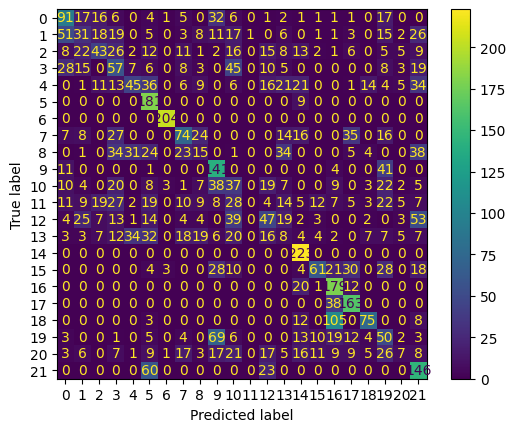

KNN
              precision    recall  f1-score   support

           0       0.71      0.80      0.75       202
           1       0.69      0.82      0.75       218
           2       0.53      0.46      0.49       207
           3       0.83      0.91      0.87       214
           4       0.84      0.90      0.87       243
           5       0.96      1.00      0.98       190
           6       1.00      1.00      1.00       204
           7       0.90      1.00      0.95       221
           8       0.85      0.96      0.90       210
           9       0.91      0.98      0.95       198
          10       0.74      0.93      0.82       195
          11       0.46      0.18      0.26       226
          12       0.80      0.69      0.74       240
          13       0.86      0.92      0.88       214
          14       1.00      1.00      1.00       223
          15       0.84      0.83      0.83       207
          16       0.96      1.00      0.98       212
          17       0.98

<Figure size 8000x8000 with 0 Axes>

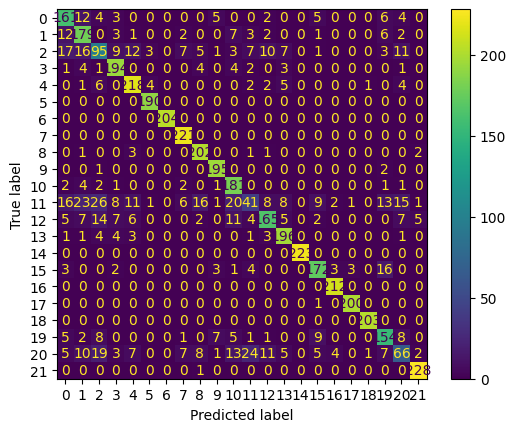

Dtree
              precision    recall  f1-score   support

           0       0.90      0.93      0.92       202
           1       0.89      0.91      0.90       218
           2       0.73      0.76      0.75       207
           3       0.94      0.93      0.93       214
           4       0.91      0.91      0.91       243
           5       0.98      1.00      0.99       190
           6       1.00      1.00      1.00       204
           7       0.96      1.00      0.98       221
           8       0.94      0.96      0.95       210
           9       0.96      0.97      0.96       198
          10       0.89      0.92      0.90       195
          11       0.64      0.59      0.61       226
          12       0.88      0.89      0.88       240
          13       0.90      0.93      0.92       214
          14       1.00      1.00      1.00       223
          15       0.91      0.92      0.92       207
          16       0.99      0.99      0.99       212
          17       0.

<Figure size 8000x8000 with 0 Axes>

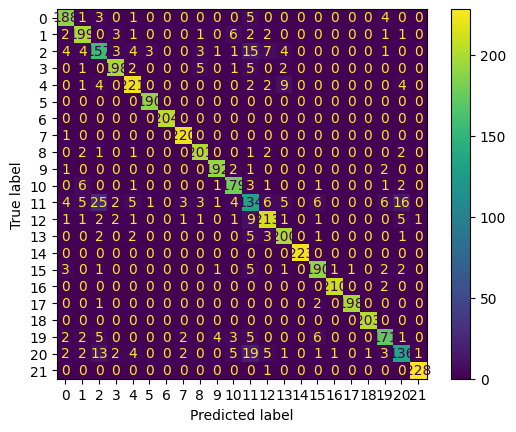

SVC
              precision    recall  f1-score   support

           0       0.65      0.51      0.58       202
           1       0.39      0.36      0.38       218
           2       0.46      0.21      0.29       207
           3       0.29      0.56      0.38       214
           4       0.44      0.17      0.25       243
           5       0.64      1.00      0.78       190
           6       1.00      1.00      1.00       204
           7       0.59      0.62      0.60       221
           8       0.35      0.44      0.39       210
           9       0.46      0.78      0.58       198
          10       0.37      0.28      0.32       195
          11       1.00      0.00      0.01       226
          12       0.38      0.25      0.30       240
          13       0.48      0.42      0.44       214
          14       0.92      1.00      0.96       223
          15       0.86      0.42      0.56       207
          16       0.75      0.76      0.75       212
          17       0.79

<Figure size 8000x8000 with 0 Axes>

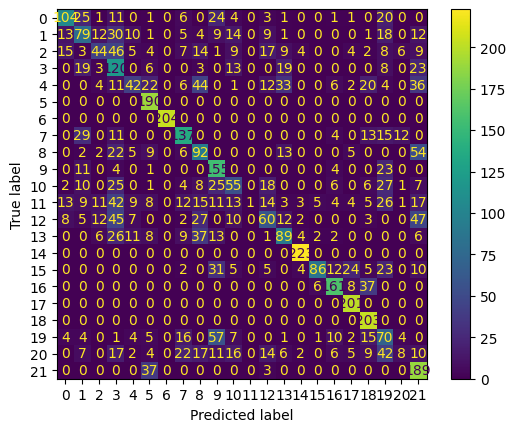

RF
              precision    recall  f1-score   support

           0       0.93      0.97      0.95       202
           1       0.92      0.95      0.94       218
           2       0.79      0.76      0.78       207
           3       0.96      0.94      0.95       214
           4       0.94      0.96      0.95       243
           5       0.98      1.00      0.99       190
           6       1.00      1.00      1.00       204
           7       0.96      1.00      0.98       221
           8       0.97      0.98      0.97       210
           9       0.98      0.98      0.98       198
          10       0.96      0.96      0.96       195
          11       0.74      0.61      0.67       226
          12       0.90      0.92      0.91       240
          13       0.95      0.98      0.96       214
          14       1.00      1.00      1.00       223
          15       0.96      0.96      0.96       207
          16       1.00      1.00      1.00       212
          17       0.99 

<Figure size 8000x8000 with 0 Axes>

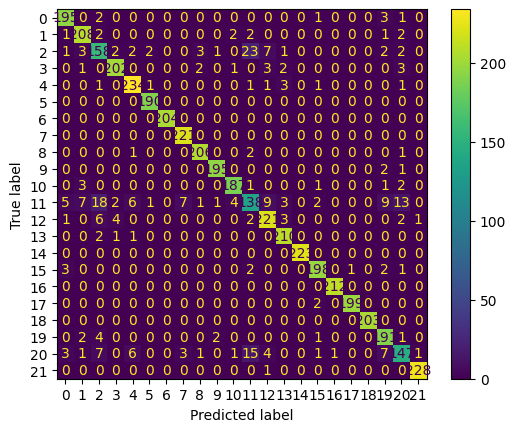

<Figure size 8000x8000 with 0 Axes>

In [171]:
# The model test report 
def report_model_test(models): 
    for name,model in models: 
        model.fit(X_train_scaled,y_train) 
        basem_preds = model.predict(X_test_scaled) 
        print(name) 
        print(classification_report(y_test,basem_preds))
        ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test) 
        plt.show() 
        plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(models) 

# Fourth Taget - Vehicle class

In [172]:
vclass_leb_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 5359 entries, 0 to 5358
Data columns (total 9 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   model_Year                  5359 non-null   int32  
 1   engine_Size                 5359 non-null   float64
 2   cylinder                    5359 non-null   float64
 3   fuelconsp_City (L/100 km)   5359 non-null   float64
 4   fuelconsp_HWY (L/100 km)    5359 non-null   float64
 5   fuelconsp_COMB1 (L/100 km)  5359 non-null   float64
 6   fuelconsp_COMB2(mpg)        5359 non-null   float64
 7   CO2_emmissions              5359 non-null   int32  
 8   vehicle_Class               5359 non-null   int32  
dtypes: float64(6), int32(3)
memory usage: 314.1 KB


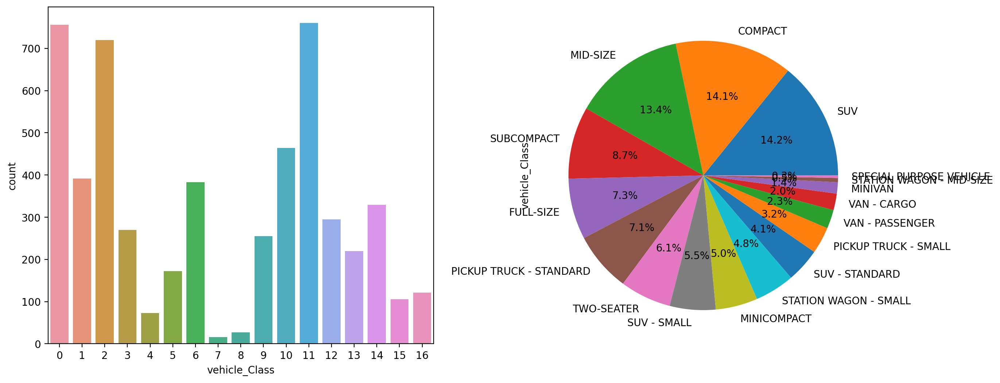

In [173]:
# balancing


fig, ax_position=plt.subplots(1,2,figsize=(15,6),dpi=200) # creates the framework for the plotting 
a = sns.countplot(x='vehicle_Class', data=vclass_leb_df, ax=ax_position[0]) #ax_position[0] specifies plot to be in index 0 
a= df['vehicle_Class'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax_position[1]) #ax_position[1] specifies plot to be in index 1 

In [174]:
# balancing the target variable for efficient machine learning
X = vclass_leb_df.drop('vehicle_Class', axis = 1) 
y = vclass_leb_df['vehicle_Class']

In [175]:
# Applying smote
from imblearn.over_sampling import SMOTE 
sm = SMOTE(random_state=42, k_neighbors = 2) # The object is created  
X_res, y_res = sm.fit_resample(X, y) # The object is applied 
X, y = X_res, y_res # reassigning the balanced dataset to X,y

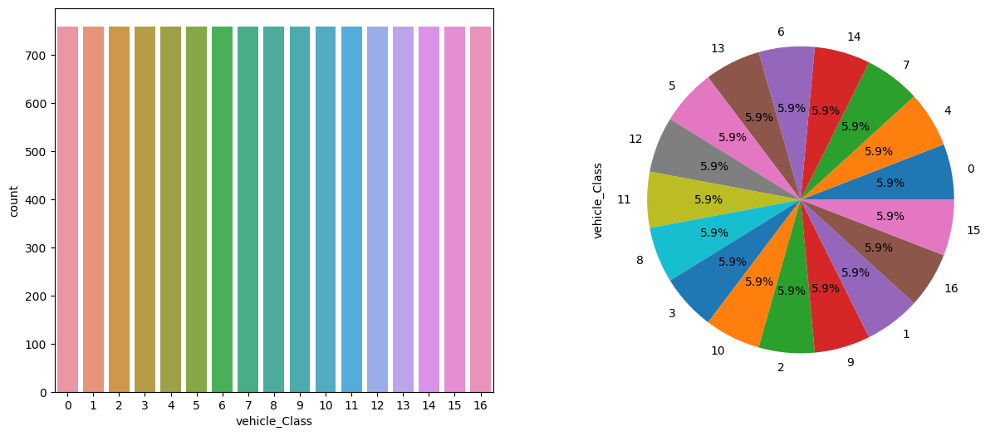

In [176]:
# Plot of the dataset   
df_bal = pd.concat([X_res,y_res], axis = 1) # creating a dataframe for the balanced data 
fig, ax=plt.subplots(1,2,figsize=(15,6)) # creating the axis shell for subplot 
a = sns.countplot(x='vehicle_Class',data=df_bal,  ax=ax[0]) # assigning each of the plot to the axis shell 
a= df_bal['vehicle_Class'].value_counts().plot.pie(autopct="%1.1f%%", ax=ax[1]) # assigning each of the plot to the axis shell 

In [177]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) 
 
X,y=X_train,y_train 
X_train, X_val, y_train, y_val = train_test_split(X, y, test_size=0.2, random_state=42) 

In [178]:
# scaling the dataset
scaler = MinMaxScaler() 
X_train_scaled = scaler.fit_transform(X_train) 
X_test_scaled = scaler.transform(X_test) 
X_val_scaled = scaler.transform(X_val) 

In [179]:
# logistic regression
model = LogisticRegression() 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


              precision    recall  f1-score   support

           0       0.20      0.16      0.18       152
           1       0.25      0.38      0.30       149
           2       0.20      0.17      0.18       142
           3       0.10      0.05      0.07       173
           4       0.32      0.19      0.24       150
           5       0.50      0.75      0.60       133
           6       0.40      0.21      0.27       173
           7       0.40      0.63      0.49       146
           8       0.00      0.00      0.00       163
           9       0.26      0.42      0.32       149
          10       0.28      0.17      0.21       155
          11       0.16      0.11      0.13       162
          12       0.27      0.51      0.35       153
          13       0.31      0.50      0.38       139
          14       0.32      0.06      0.10       160
          15       0.57      0.64      0.60       143
          16       0.60      0.67      0.63       142

    accuracy              

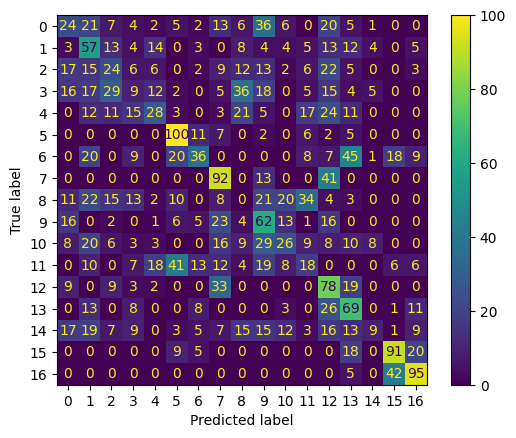

<Figure size 8000x8000 with 0 Axes>

In [180]:
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model)

In [181]:
# decision tree
model = DecisionTreeClassifier() 

                            Feature_importance
fuelconsp_COMB2(mpg)                  0.024873
cylinder                              0.062842
fuelconsp_COMB1 (L/100 km)            0.067963
model_Year                            0.093941
CO2_emmissions                        0.128359
fuelconsp_City (L/100 km)             0.178951
engine_Size                           0.207871
fuelconsp_HWY (L/100 km)              0.235200
              precision    recall  f1-score   support

           0       0.39      0.39      0.39       152
           1       0.68      0.74      0.71       149
           2       0.53      0.59      0.56       142
           3       0.80      0.91      0.85       173
           4       0.91      0.94      0.92       150
           5       0.96      0.99      0.97       133
           6       0.84      0.82      0.83       173
           7       0.98      0.97      0.97       146
           8       0.98      0.98      0.98       163
           9       0.69      0.72   

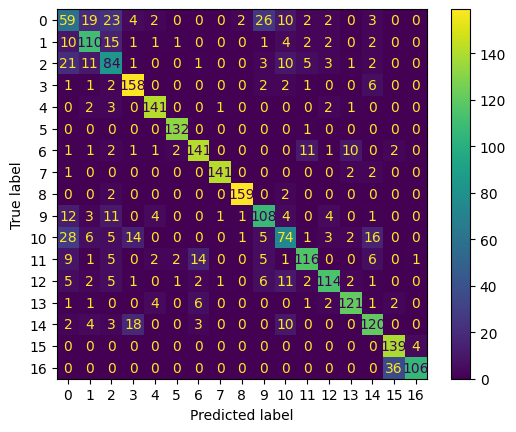

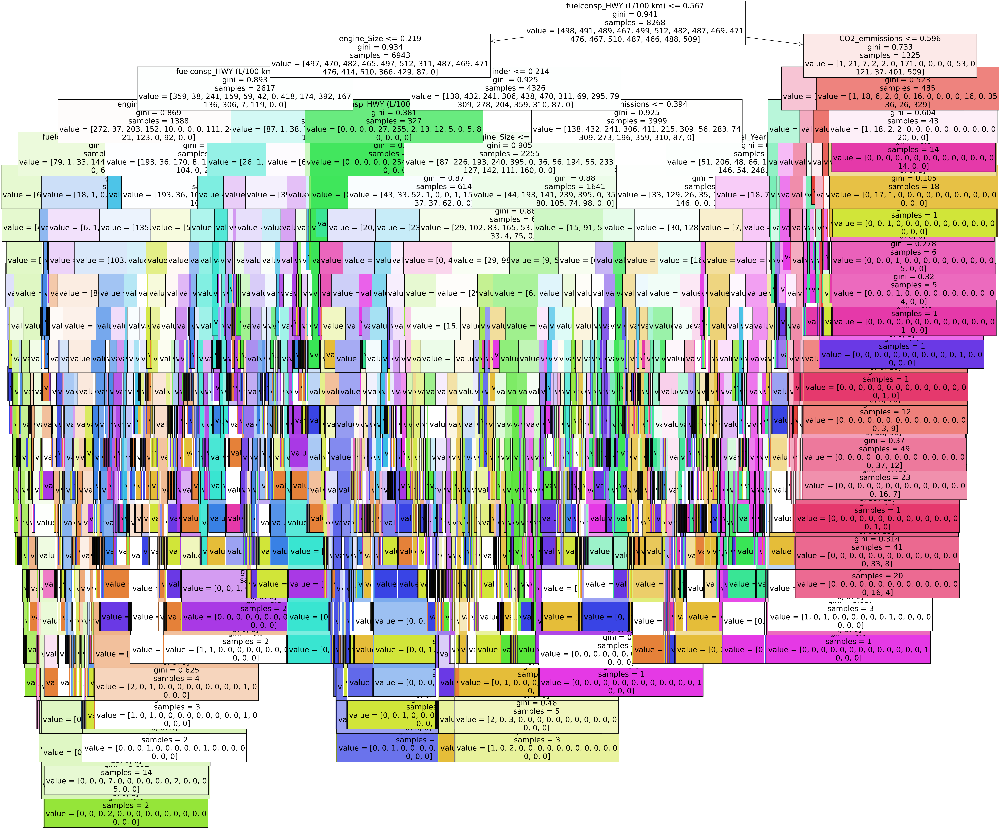

In [182]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled) 
    
    feature_importance=pd.DataFrame(data=model.feature_importances_, index = X.columns, 
             columns = ['Feature_importance']).sort_values('Feature_importance') 
    print(feature_importance) 
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model,X_test_scaled, y_test) 
    
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
    plot_tree(model, feature_names = X.columns, filled = True, fontsize=20 ); 
     
report_model_test(model) 

In [183]:
# KNeighborsClassifier 
from sklearn.neighbors import KNeighborsClassifier 

In [184]:
model = KNeighborsClassifier() # instance of the model object

              precision    recall  f1-score   support

           0       0.27      0.27      0.27       152
           1       0.53      0.69      0.60       149
           2       0.47      0.30      0.36       142
           3       0.67      0.83      0.74       173
           4       0.84      0.91      0.87       150
           5       0.89      0.98      0.94       133
           6       0.71      0.65      0.68       173
           7       0.95      1.00      0.97       146
           8       0.85      0.96      0.90       163
           9       0.56      0.67      0.61       149
          10       0.42      0.32      0.37       155
          11       0.64      0.33      0.44       162
          12       0.72      0.76      0.74       153
          13       0.77      0.83      0.80       139
          14       0.63      0.48      0.55       160
          15       0.74      0.88      0.81       143
          16       0.83      0.83      0.83       142

    accuracy              

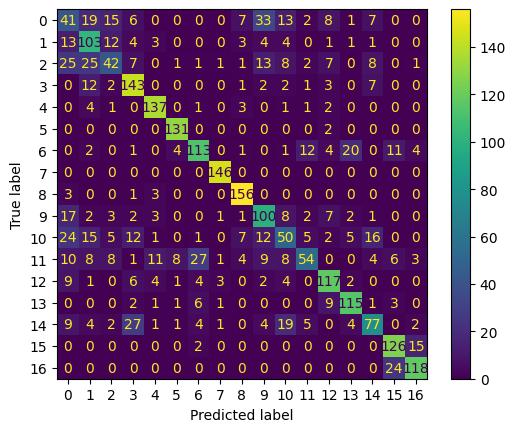

<Figure size 8000x8000 with 0 Axes>

In [185]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

In [186]:
# Support vector machines (svm)
from sklearn.svm import SVC # SVC: support vector classifier  
model = SVC()

              precision    recall  f1-score   support

           0       0.20      0.16      0.18       152
           1       0.38      0.43      0.41       149
           2       0.63      0.15      0.25       142
           3       0.41      0.32      0.36       173
           4       0.32      0.53      0.40       150
           5       0.65      0.77      0.71       133
           6       0.43      0.32      0.37       173
           7       0.61      0.62      0.62       146
           8       0.59      0.43      0.50       163
           9       0.28      0.44      0.34       149
          10       0.35      0.18      0.24       155
          11       0.58      0.18      0.27       162
          12       0.29      0.63      0.40       153
          13       0.38      0.70      0.50       139
          14       0.54      0.17      0.26       160
          15       0.57      0.86      0.69       143
          16       0.89      0.68      0.77       142

    accuracy              

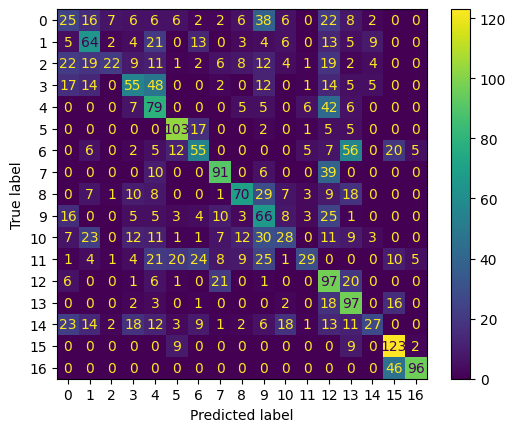

<Figure size 8000x8000 with 0 Axes>

In [187]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

In [188]:
# Random forest
from sklearn.ensemble import RandomForestClassifier 
model = RandomForestClassifier()


              precision    recall  f1-score   support

           0       0.45      0.39      0.42       152
           1       0.77      0.77      0.77       149
           2       0.60      0.66      0.63       142
           3       0.83      0.94      0.88       173
           4       0.97      0.95      0.96       150
           5       0.96      0.99      0.98       133
           6       0.87      0.83      0.85       173
           7       1.00      0.99      0.99       146
           8       0.98      0.98      0.98       163
           9       0.73      0.80      0.76       149
          10       0.66      0.59      0.62       155
          11       0.83      0.77      0.80       162
          12       0.85      0.86      0.86       153
          13       0.89      0.94      0.91       139
          14       0.80      0.76      0.78       160
          15       0.79      0.93      0.86       143
          16       0.90      0.77      0.83       142

    accuracy              

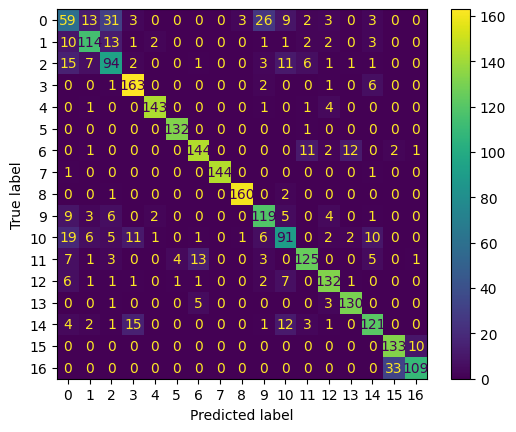

<Figure size 8000x8000 with 0 Axes>

In [189]:
# The model test report 
def report_model_test(model): 
    model.fit(X_train_scaled,y_train) 
    basem_preds = model.predict(X_test_scaled)     
    print(classification_report(y_test,basem_preds)) 
    ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test)
    plt.show() 
    plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(model) 

In [190]:
# cross validation of the model
from sklearn.linear_model import LogisticRegression 
from sklearn.model_selection import cross_validate, KFold, cross_val_score 
from sklearn.metrics import make_scorer, accuracy_score, precision_score, recall_score, f1_score 

In [191]:
# Appending several models for cross validation 
models = []  
models.append(("LR",LogisticRegression())) 
models.append(("KNN",KNeighborsClassifier())) 
models.append(("Dtree",DecisionTreeClassifier())) 
models.append(("SVC",SVC())) 
models.append(("RF",RandomForestClassifier()))
 
models 

[('LR', LogisticRegression()),
 ('KNN', KNeighborsClassifier()),
 ('Dtree', DecisionTreeClassifier()),
 ('SVC', SVC()),
 ('RF', RandomForestClassifier())]

In [192]:
def report_cross_val_score(models): 
    for name,model in models: 
        kfold = KFold(n_splits=5) 
        cv_result = cross_val_score(model,X_train,y_train, cv = kfold,scoring = "accuracy") 
        print(name, cv_result) 
        print("Mean is:", name, cv_result.mean()) 
        print("Standard Deviation is:", name, cv_result.std())
             
report_cross_val_score(models) 

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stab

LR [0.29564692 0.25272068 0.20556227 0.29098609 0.27586207]
Mean is: LR 0.2641556043718102
Standard Deviation is: LR 0.03290153432808446
KNN [0.6668682  0.62333736 0.68681983 0.64065336 0.65214761]
Mean is: KNN 0.6539652721847566
Standard Deviation is: KNN 0.02174620540027127
Dtree [0.77206771 0.77267231 0.7732769  0.76709014 0.7707199 ]
Mean is: Dtree 0.7711653942010093
Standard Deviation is: Dtree 0.0022067903253102715
SVC [0.1426844  0.15114873 0.13905683 0.15789474 0.14398064]
Mean is: SVC 0.14695306836494565
Standard Deviation is: SVC 0.0067339598846727616
RF [0.81136638 0.81318017 0.8095526  0.81004235 0.80036298]
Mean is: RF 0.8089008954442145
Standard Deviation is: RF 0.004450045241080474


c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\linear_model\_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


LR
              precision    recall  f1-score   support

           0       0.20      0.16      0.18       152
           1       0.25      0.38      0.30       149
           2       0.20      0.17      0.18       142
           3       0.10      0.05      0.07       173
           4       0.32      0.19      0.24       150
           5       0.50      0.75      0.60       133
           6       0.40      0.21      0.27       173
           7       0.40      0.63      0.49       146
           8       0.00      0.00      0.00       163
           9       0.26      0.42      0.32       149
          10       0.28      0.17      0.21       155
          11       0.16      0.11      0.13       162
          12       0.27      0.51      0.35       153
          13       0.31      0.50      0.38       139
          14       0.32      0.06      0.10       160
          15       0.57      0.64      0.60       143
          16       0.60      0.67      0.63       142

    accuracy           

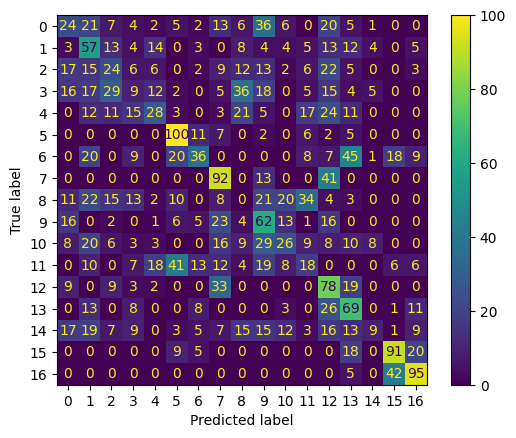

KNN
              precision    recall  f1-score   support

           0       0.27      0.27      0.27       152
           1       0.53      0.69      0.60       149
           2       0.47      0.30      0.36       142
           3       0.67      0.83      0.74       173
           4       0.84      0.91      0.87       150
           5       0.89      0.98      0.94       133
           6       0.71      0.65      0.68       173
           7       0.95      1.00      0.97       146
           8       0.85      0.96      0.90       163
           9       0.56      0.67      0.61       149
          10       0.42      0.32      0.37       155
          11       0.64      0.33      0.44       162
          12       0.72      0.76      0.74       153
          13       0.77      0.83      0.80       139
          14       0.63      0.48      0.55       160
          15       0.74      0.88      0.81       143
          16       0.83      0.83      0.83       142

    accuracy          

<Figure size 8000x8000 with 0 Axes>

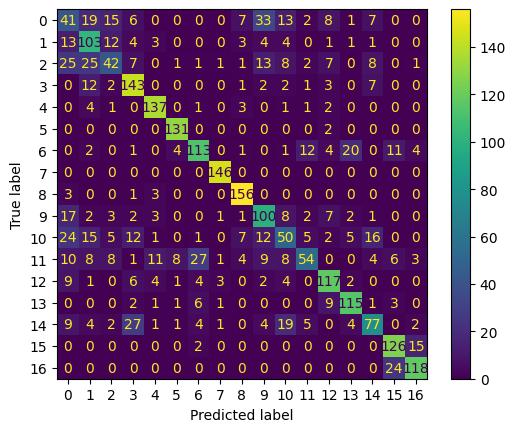

Dtree
              precision    recall  f1-score   support

           0       0.40      0.38      0.39       152
           1       0.69      0.74      0.72       149
           2       0.56      0.61      0.58       142
           3       0.80      0.92      0.86       173
           4       0.92      0.93      0.92       150
           5       0.97      0.99      0.98       133
           6       0.85      0.82      0.83       173
           7       0.99      0.96      0.97       146
           8       0.99      0.99      0.99       163
           9       0.69      0.73      0.71       149
          10       0.58      0.51      0.54       155
          11       0.82      0.72      0.76       162
          12       0.85      0.75      0.80       153
          13       0.85      0.87      0.86       139
          14       0.76      0.76      0.76       160
          15       0.78      0.97      0.86       143
          16       0.95      0.75      0.83       142

    accuracy        

<Figure size 8000x8000 with 0 Axes>

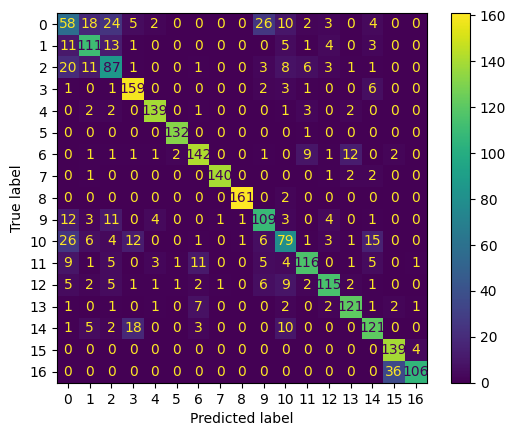

SVC
              precision    recall  f1-score   support

           0       0.20      0.16      0.18       152
           1       0.38      0.43      0.41       149
           2       0.63      0.15      0.25       142
           3       0.41      0.32      0.36       173
           4       0.32      0.53      0.40       150
           5       0.65      0.77      0.71       133
           6       0.43      0.32      0.37       173
           7       0.61      0.62      0.62       146
           8       0.59      0.43      0.50       163
           9       0.28      0.44      0.34       149
          10       0.35      0.18      0.24       155
          11       0.58      0.18      0.27       162
          12       0.29      0.63      0.40       153
          13       0.38      0.70      0.50       139
          14       0.54      0.17      0.26       160
          15       0.57      0.86      0.69       143
          16       0.89      0.68      0.77       142

    accuracy          

<Figure size 8000x8000 with 0 Axes>

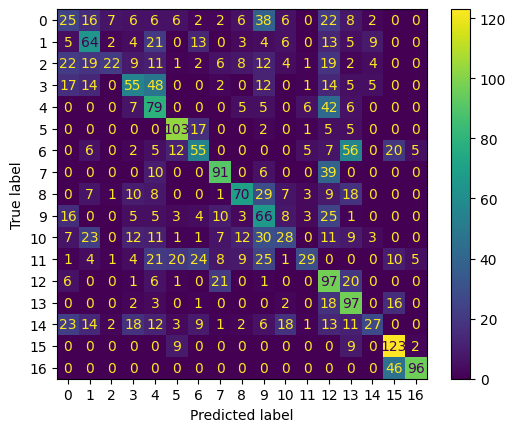

RF
              precision    recall  f1-score   support

           0       0.46      0.38      0.42       152
           1       0.75      0.75      0.75       149
           2       0.64      0.67      0.66       142
           3       0.83      0.95      0.89       173
           4       0.96      0.97      0.96       150
           5       0.97      0.99      0.98       133
           6       0.88      0.83      0.85       173
           7       1.00      0.98      0.99       146
           8       0.96      0.99      0.98       163
           9       0.70      0.81      0.75       149
          10       0.64      0.57      0.60       155
          11       0.84      0.79      0.81       162
          12       0.84      0.85      0.84       153
          13       0.90      0.92      0.91       139
          14       0.81      0.77      0.79       160
          15       0.78      0.97      0.87       143
          16       0.95      0.75      0.83       142

    accuracy           

<Figure size 8000x8000 with 0 Axes>

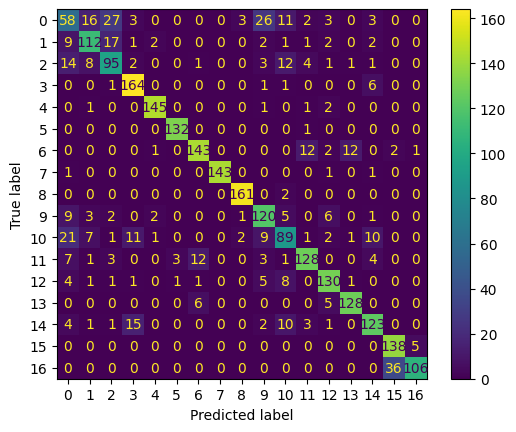

<Figure size 8000x8000 with 0 Axes>

In [193]:
# The model test report 
def report_model_test(models): 
    for name,model in models: 
        model.fit(X_train_scaled,y_train) 
        basem_preds = model.predict(X_test_scaled) 
        print(name) 
        print(classification_report(y_test,basem_preds))
        ConfusionMatrixDisplay.from_estimator(model, X_test_scaled, y_test) 
        plt.show() 
        plt.figure(figsize=(40,40), dpi = 200); 
     
     
report_model_test(models) 

# CLUSTERING

In [194]:
num_df_clas

,model_Year,engine_Size,cylinder,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions
0,2010,2.0,4.0,10.9,7.8,9.5,30.0,219
1,2010,2.0,4.0,10.0,7.6,8.9,32.0,205
2,2010,2.0,4.0,11.6,8.1,10.0,28.0,230
3,2010,3.7,6.0,14.8,11.3,13.2,21.0,304
4,2010,2.3,4.0,13.2,10.3,11.9,24.0,274
...,...,...,...,...,...,...,...,...
5354,2014,3.0,6.0,13.4,9.8,11.8,24.0,271
5355,2014,3.2,6.0,13.2,9.5,11.5,25.0,264
5356,2014,3.0,6.0,13.4,9.8,11.8,24.0,271
5357,2014,3.2,6.0,12.9,9.3,11.3,25.0,260


In [195]:
from sklearn.metrics import davies_bouldin_score, silhouette_score
from sklearn.cluster import AgglomerativeClustering, KMeans
from sklearn.preprocessing import MinMaxScaler, StandardScaler

In [196]:
#scaling
m = MinMaxScaler()
s = StandardScaler()

In [197]:
num_df_class_scaled = s.fit_transform(num_df_clas)
num_df_class_minscaled = m.fit_transform(num_df_clas)

In [198]:
num_df = pd.DataFrame(num_df_class_scaled, columns = num_df_clas.columns)

In [199]:
model = AgglomerativeClustering(n_clusters=5,linkage='single')
cluster_labels = model.fit_predict(num_df_class_scaled)

In [200]:
# the lower the db score, the better the cluster
DB_index=davies_bouldin_score(num_df_class_scaled,cluster_labels)
DB_index

0.4811546667336639

In [201]:
#the higher the sil score, the better the cluster
sil_index = silhouette_score(num_df_class_scaled, cluster_labels)
sil_index

0.2640688372672149

# vehicle_class clustering result

In [202]:
vclass_scaled = s.fit_transform(vclass_leb_df)
vclass_minscaled = m.fit_transform(vclass_leb_df)

In [203]:
v_df = pd.DataFrame(vclass_scaled, columns = vclass_leb_df.columns)

In [204]:
model = AgglomerativeClustering(n_clusters=5,linkage='single')
cluster_labels = model.fit_predict(vclass_scaled)

In [205]:
DB_index=davies_bouldin_score(vclass_scaled,cluster_labels)
DB_index

0.5736500447389363

In [206]:
#the higher the sil score, the better the cluster
sil_index = silhouette_score(vclass_scaled, cluster_labels)
sil_index

0.2561842622933765

In [207]:
# transmission clustering result
trans_scaled = s.fit_transform(trans_leb_df)
trans_minscaled = m.fit_transform(trans_leb_df)

In [208]:
trans_df = pd.DataFrame(trans_scaled, columns = trans_leb_df.columns)

In [209]:
model = AgglomerativeClustering(n_clusters=5,linkage='single')
cluster_labels = model.fit_predict(trans_scaled)

In [210]:
DB_index=davies_bouldin_score(trans_scaled,cluster_labels)
DB_index

0.4559335147140807

In [211]:
#the higher the sil score, the better the cluster
sil_index = silhouette_score(trans_scaled, cluster_labels)
sil_index

0.27364762981730856

# fuel type clustering result

In [212]:
fuel_scaled = s.fit_transform(fuel_leb_df)
fuel_minscaled = m.fit_transform(fuel_leb_df)

In [213]:
fuel_df = pd.DataFrame(fuel_scaled, columns = fuel_leb_df.columns)

In [214]:
model = AgglomerativeClustering(n_clusters=5,linkage='single')
cluster_labels = model.fit_predict(fuel_scaled)

In [215]:
DB_index=davies_bouldin_score(fuel_scaled,cluster_labels)
DB_index

0.72444936800414

In [216]:
#the higher the sil score, the better the cluster
sil_index = silhouette_score(fuel_scaled, cluster_labels)
sil_index

0.09155471812423668

# cylinder

In [217]:
cyld_scaled = s.fit_transform(leb_df)
cyld_minscaled = m.fit_transform(leb_df)

In [218]:
cyld_df = pd.DataFrame(cyld_scaled, columns = leb_df.columns)

In [219]:
model = AgglomerativeClustering(n_clusters=5,linkage='single')
cluster_labels = model.fit_predict(cyld_scaled)

In [220]:
DB_index=davies_bouldin_score(cyld_scaled,cluster_labels)
DB_index

0.7194711302713458

In [221]:
#the higher the sil score, the better the cluster
sil_index = silhouette_score(cyld_scaled, cluster_labels)
sil_index

0.24299561362467093

Transmission categorical variable has the lowest Davies-Bouldin index and the highest sil index, hence it is the variable that best describes the groups formed

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `

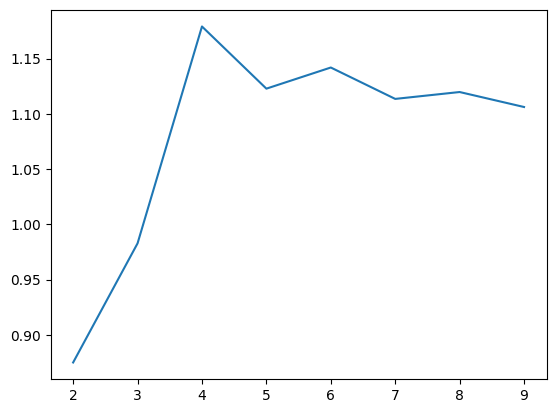

In [222]:
cluster_n = range(2,10)
labels = []
n = []
for k in cluster_n:
    model = KMeans(n_clusters=k)
    cluster_labels = model.fit_predict(num_df_class_scaled)
    DB_index=davies_bouldin_score(num_df_class_scaled,cluster_labels)
    labels.append(DB_index)
    n.append(k)
plt.plot(n, labels)
plt.show() 

In [223]:
cluster_labels = list(set(cluster_labels))
len(cluster_labels)

9

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `

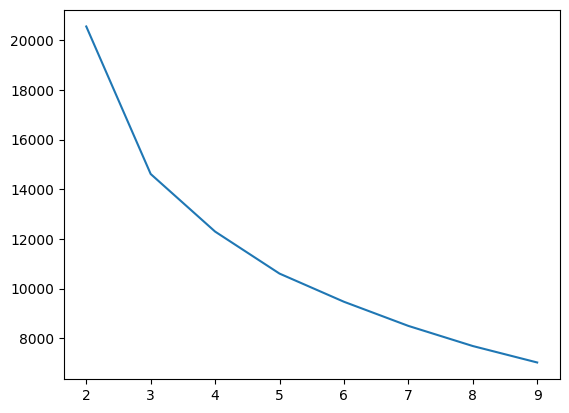

In [224]:
cluster_n = range(2,10)
sum_squared = []
n = []
for k in cluster_n:
    model = KMeans(n_clusters=k, max_iter = 200)
    model.fit(num_df_class_scaled)
    sum_squared.append(model.inertia_)
    n.append(k)
    
plt.plot(n, sum_squared)
plt.show() 
# plt.plot(n, cluster_labels)
# plt.xlabel('Values of K') 
# plt.ylabel('Distortion')
# plt.title('The Elbow Method using Distortion')
# plt.show()

In [225]:
model = KMeans(n_clusters=4)
predict_clusters = model.fit_predict(num_df_class_scaled)

c:\users\sameb\appdata\local\programs\python\python38\lib\site-packages\sklearn\cluster\_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


In [226]:
df['clusters'] = list(predict_clusters)

In [227]:
df[df.vehicle_Class == 'COMPACT'].head(20)

,model_Year,MAKE,Model#,vehicle_Class,engine_Size,cylinder,transmission,fuel_Type,fuelconsp_City (L/100 km),fuelconsp_HWY (L/100 km),fuelconsp_COMB1 (L/100 km),fuelconsp_COMB2(mpg),CO2_emmissions,clusters
0,2010,ACURA,CSX,COMPACT,2.0,4.0,AS5,X,10.9,7.8,9.5,30.0,219,2
1,2010,ACURA,CSX,COMPACT,2.0,4.0,M5,X,10.0,7.6,8.9,32.0,205,2
2,2010,ACURA,CSX,COMPACT,2.0,4.0,M6,Z,11.6,8.1,10.0,28.0,230,0
9,2010,ACURA,TSX,COMPACT,2.4,4.0,AS5,Z,11.0,7.8,9.5,30.0,219,0
10,2010,ACURA,TSX,COMPACT,2.4,4.0,M6,Z,11.9,8.3,10.3,27.0,237,0
11,2010,ACURA,TSX,COMPACT,3.5,6.0,AS5,Z,12.8,8.8,11.0,26.0,253,0
22,2010,AUDI,A4,COMPACT,2.0,4.0,AV,Z,10.2,7.8,9.1,31.0,209,2
24,2010,AUDI,A4 QUATTRO,COMPACT,2.0,4.0,AS6,Z,11.5,8.7,10.2,28.0,235,0
25,2010,AUDI,A4 QUATTRO,COMPACT,2.0,4.0,M6,Z,10.8,7.8,9.4,30.0,216,2
44,2010,AUDI,S4,COMPACT,3.0,6.0,AS7,Z,13.6,9.4,11.7,24.0,269,0
